# Computational Profiling Reveals Age- and MDS-Related Changes in Hematopoietic Stem and Progenitor Cell Kinetics
## Results fit model A
#### author: Lisa Bast

#### call defined functions:

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as col
import matplotlib.patches as patches
from matplotlib.patches import Ellipse
from matplotlib import rc
from matplotlib.ticker import FuncFormatter
import matplotlib.transforms as transforms
import matplotlib.style
import scipy.io as sio
import fnmatch as fnm
import h5py
import math
import os
import re
import statsmodels.formula.api as sm
from statsmodels.stats.weightstats import DescrStatsW
from scipy import stats
from scipy.stats import chi2
from sklearn.preprocessing import StandardScaler
%matplotlib inline

#### specify colors and cell type compartments

In [2]:
np.set_printoptions(precision=4)
sns.set()
sns.set(style="whitegrid")

CT = ['HSC','MPP','MLP','CMP','GMP','MEP','mat']
cols_CT = sns.color_palette(['#CC0000','#FF8000','#003366','#6600CC','#00994C','#57D7F7','#FFE00E','#A0A0A0']);

#colors = ['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075', '#808080', '#ffffff', '#000000']

col_H = '#194795'
col_H_light = '#0F2F66'
col_H_y = '#57B8F9'
col_H_y_light = '#279DEC'
col_H_a = '#194795'
col_H_a_light = '#0F2F66'
col_MDS = '#C61D1D'
col_MDS_light = '#791010'
col_MDS_m1 = '#FD8002'
col_MDS_m2 = '#AD07E3'
col_MDS_m3 = '#FF0000'
col_MDS_m4 = '#FF3399'
col_MDS_m5 = '#813434'
col_MDS_m6 = '#FF0010'
col_MDS_m7 = '#813437'
col_MDS_m8 = '#834537'
col_CHIP = '#009999'
col_CHIP_light = '#00FFFF'

cols_H_vs_MDS = sns.color_palette([col_H,col_MDS])
cols_H_vs_MDS_light = sns.color_palette([col_H_light,col_MDS_light])
cols_H_vs_MDS_mut = sns.color_palette([col_H,col_MDS,col_MDS_m1,col_MDS_m2,col_MDS_m3,col_MDS_m4,col_MDS_m5,col_MDS_m6,col_MDS_m7,col_MDS_m8])

cols_H_y_vs_MDS = sns.color_palette([col_H_y,col_MDS])
cols_H_y_vs_MDS_light = sns.color_palette([col_H_y_light,col_MDS_light])

cols_H_vs_CHIP_vs_MDS = sns.color_palette([col_H,col_CHIP,col_MDS])
cols_H_vs_CHIP_vs_MDS_light = sns.color_palette([col_H_light,col_CHIP_light,col_MDS_light])

cols_H_y_vs_H_a = sns.color_palette([col_H_y, col_H_a])
cols_H_y_vs_H_a_light = sns.color_palette([col_H_y_light, col_H_a_light])

cols_H_y_vs_H_a_vs_MDS = sns.color_palette([col_H_y, col_H_a, col_MDS])
cols_H_y_vs_H_a_vs_MDS_light = sns.color_palette([col_H_y_light, col_H_a_light, col_MDS_light])

cols_status_3 = sns.color_palette([col_H_y_light,col_H_a_light,col_MDS_light])
cols_status_light_3 = sns.color_palette([col_H_y,col_H_a,col_MDS])

cols_BMtype_3 = sns.color_palette(['#009999','#99004C','#CC6600'])
cols_BMtype_light_3 = sns.color_palette(['#00FFFF','#FF007F','#FF9933'])

#### specify path were results can be found and figures should be saved 

In [3]:
#os.chdir('../')

In [4]:
dir_str = os.getcwd()

In [5]:
dir_str

'D:\\Documents\\MATLAB\\HematopoieticDisorderAnalysis\\Python\\results_visualization'

#### specify if figures should be saved

In [6]:
opt_save = True

#### load defined functions

In [7]:
os.chdir(dir_str)
#os.getcwd()
%run "definedFunctions.ipynb"

#### set general graphic settings

In [8]:
plt = loadPltSettings(40,10) #fonsize, markersize

#### specify MATLAB results subfolders 

In [9]:
opt_sample_ID = 'short' #'long'
bool_fit_repetitions_seperately=False#True #
if bool_fit_repetitions_seperately:
    opt_sample_ID = 'long'
else:
    opt_sample_ID = 'short'

folder_str_H_MDS = []
folder_str_H_MDS.append("/results_fit_samples_7divs_3iS_HO_LogNormal_fit_iC/")

subfolder_str_H_MDS = []
subfolder_str_H_MDS.append("model_A_model/")

M_names_sim = list('A')
M_names_opt = list('A')

if bool_fit_repetitions_seperately:
    I_names =['311_1','312_1','312_2','345_1','348_1','353_1','370_1','380_1','391_1','391_2','439_1','450_1','482_1','500_1','508_1','519_1','522_1','547_1','552_1','559_1','560_1','561_1','135_1','140_1','215_1','227_1','279_1','326_1','354_1','360_1','373_1','377_1','460_1']
    I_names_H = I_names[0:22]
    I_names_MDS = I_names[22:33]
else:
    I_names =['311','312','345','348','353','370','380','391','439','450','482','500','508','519','522','547','552','559','560','561','135','140','215','227','279','326','354','360','373','377','460']
    I_names_H = I_names[0:20]
    I_names_MDS = I_names[20:31]              
last_subsubfolder_str=list()
last_subsubfolder_str.append("individual_"+I_names_H[len(I_names_H)-1])
last_subsubfolder_str.append("individual_"+I_names_MDS[len(I_names_MDS)-1])

#call individuals_str from .mat file within par plot
subsubfolder_str_H_MDS = []
for I_ID in I_names:
    subsubfolder_str_H_MDS.append("individual_"+I_ID) 

samples_excluded_MDS = ["110","433","173","215","460"]
samples_excluded_H = ['450']#["391"]

In [10]:
#I_names_MDS

In [11]:
#last_subsubfolder_str

### Parameter and confidence intervals

In [12]:
os.chdir('../')
os.chdir('../')
os.chdir('./MATLAB/parameter_inference/')
matlab_dir_str = os.getcwd()

In [145]:
os.chdir(dir_str)
#os.getcwd()
%run "definedFunctions.ipynb"

0.017460208818032088
[0.0037 0.0432]
0.024655813973762035
[0.0185 0.0392]
0.010904760606457812
[0.0015 0.0252]
0.03736563626361417
[0.0008 0.0876]
0.033890079054884975
[0.0016 0.1069]
0.0665722534068035
[0.0475 0.1045]
0.013697839619770075
[0.0009 0.1035]
0.08590045357998284
[0.0012 0.2467]
0.050310440467548075
[0.0271 0.1125]
0.019525153795445085
[0.0094 0.055 ]
0.08524359449914068
[0.0116 0.3718]
0.06692270964190208
[0.0263 0.1509]
0.10607289263710554
[6.7288e-04 1.3768e+00]


C:\Users\PowerWS\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in sqrt
C:\Users\PowerWS\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in sqrt
C:\Users\PowerWS\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in sqrt


0.015155256658111082
[0.0004 0.0883]
0.06074209342959836
[0.0316 0.1213]
0.025538509116934834
[0.0004 0.2385]
0.30299435113435125
[7.6328e-04 1.2276e+00]
0.14134274093429533
[0.0242 0.9346]
0.2338625068268348
[5.9245e-04 1.8924e+00]


C:\Users\PowerWS\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in sqrt


0.05268625516902771
[0.0301 0.102 ]
0.0026662815335733647
[0.0003 0.0111]


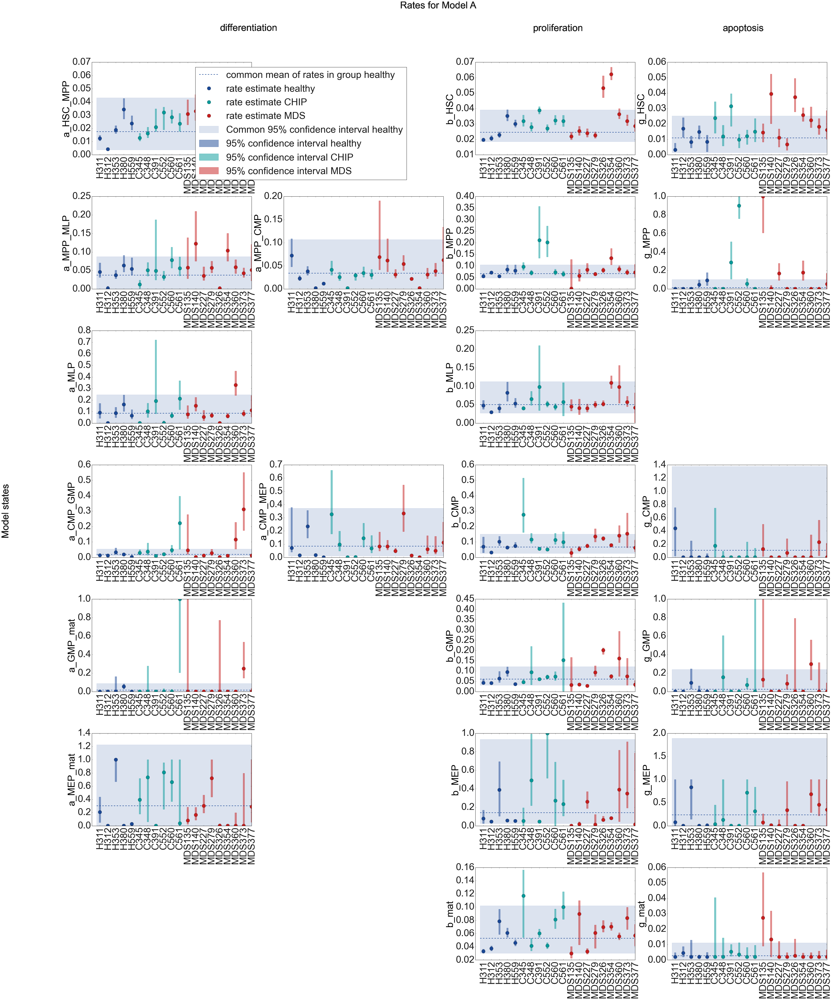

In [146]:
par_T = 'lin'
rot_deg = 90
opt_comparison = 'H_age_matched_vs_CHIP_vs_MDS'
colors = cols_H_vs_CHIP_vs_MDS 
bool_test_par = False
#alpha_errorband = 0.01
alpha_errorband = 0.01
os.chdir(dir_str)
plot_par_with_CI_vs_individuals(matlab_dir_str, folder_str_H_MDS, subfolder_str_H_MDS, subsubfolder_str_H_MDS, last_subsubfolder_str, samples_excluded_H, samples_excluded_MDS, M_names_sim, M_names_opt, CT, par_T, colors, opt_comparison, rot_deg, opt_sample_ID,bool_fit_repetitions_seperately,False,alpha_errorband,opt_save)

-1.7573494671962615
[-2.4276 -1.3587]
-1.6081612351316605
[-1.7323 -1.4067]
-1.9647931758655839
[-2.8248 -1.6246]
-1.428480250024572
[-3.104  -1.0538]
-1.4722860997743823
[-2.7926 -0.9643]
-1.1764075260560887
[-1.3213 -0.9814]
-1.8688743452182028
[-3.0121 -1.0056]
-1.0650980658479445
[-2.9186 -0.5997]
-1.3020095021920772
[-1.5651 -0.9539]
-1.7096498519951917
[-2.0328 -1.2417]
-1.0699461162860355
[-1.9605 -0.4229]
-1.1749998454346207
[-1.5875 -0.8208]
-0.9277882063100699
[-3.164   0.2002]


C:\Users\PowerWS\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in sqrt
C:\Users\PowerWS\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in sqrt
C:\Users\PowerWS\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in sqrt


-1.81156403140264
[-3.3788 -1.0304]
-1.2184491595214388
[-1.4948 -0.9176]
-1.5856073962286859
[-3.4207 -0.5878]
-0.5186990822371927
[-3.0968  0.082 ]
-0.8467780436084212
[-1.5957 -0.0794]
-0.6353025995385939
[-3.1876  0.2605]


C:\Users\PowerWS\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in sqrt


-1.2796364787351067
[-1.5252 -0.9939]
-2.586399948038339
[-3.608  -2.0235]


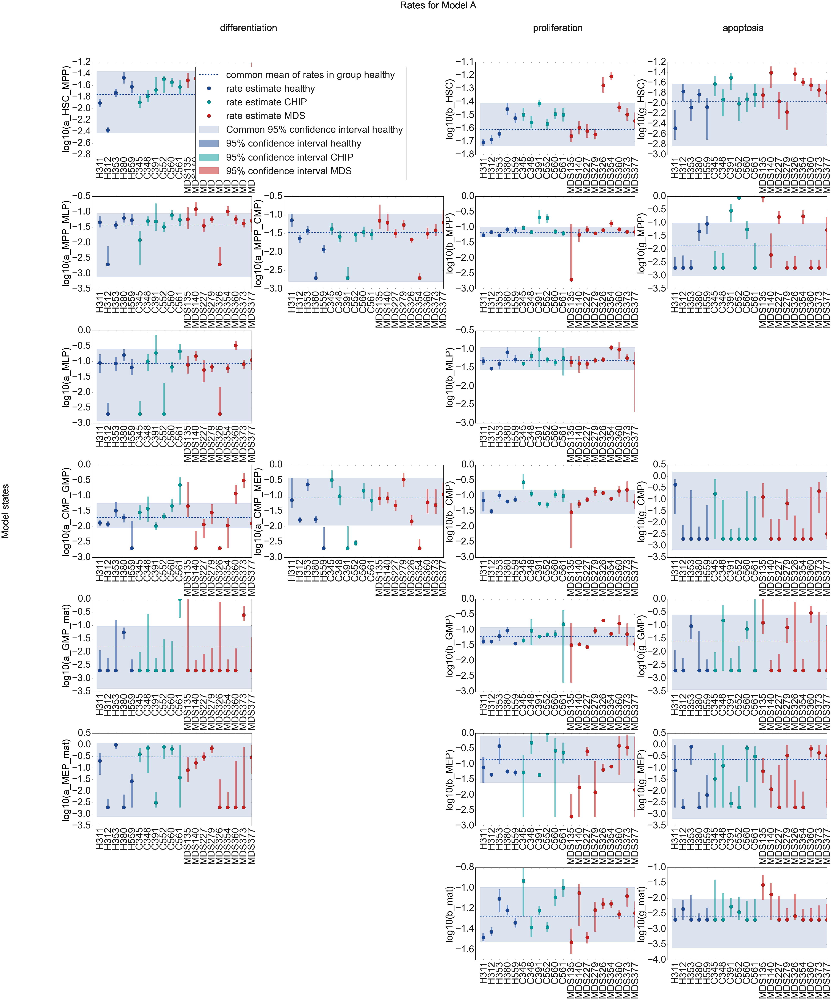

In [147]:
#par_T = 'lin'
par_T = 'log10'
rot_deg = 90
opt_comparison = 'H_age_matched_vs_CHIP_vs_MDS'
colors = cols_H_vs_CHIP_vs_MDS 
bool_test_par = False
alpha_errorband = 0.01
#alpha_errorband = 0.05
os.chdir(dir_str)
plot_par_with_CI_vs_individuals(matlab_dir_str, folder_str_H_MDS, subfolder_str_H_MDS, subsubfolder_str_H_MDS, last_subsubfolder_str, samples_excluded_H, samples_excluded_MDS, M_names_sim, M_names_opt, CT, par_T, colors, opt_comparison, rot_deg, opt_sample_ID,bool_fit_repetitions_seperately,False,alpha_errorband,opt_save)

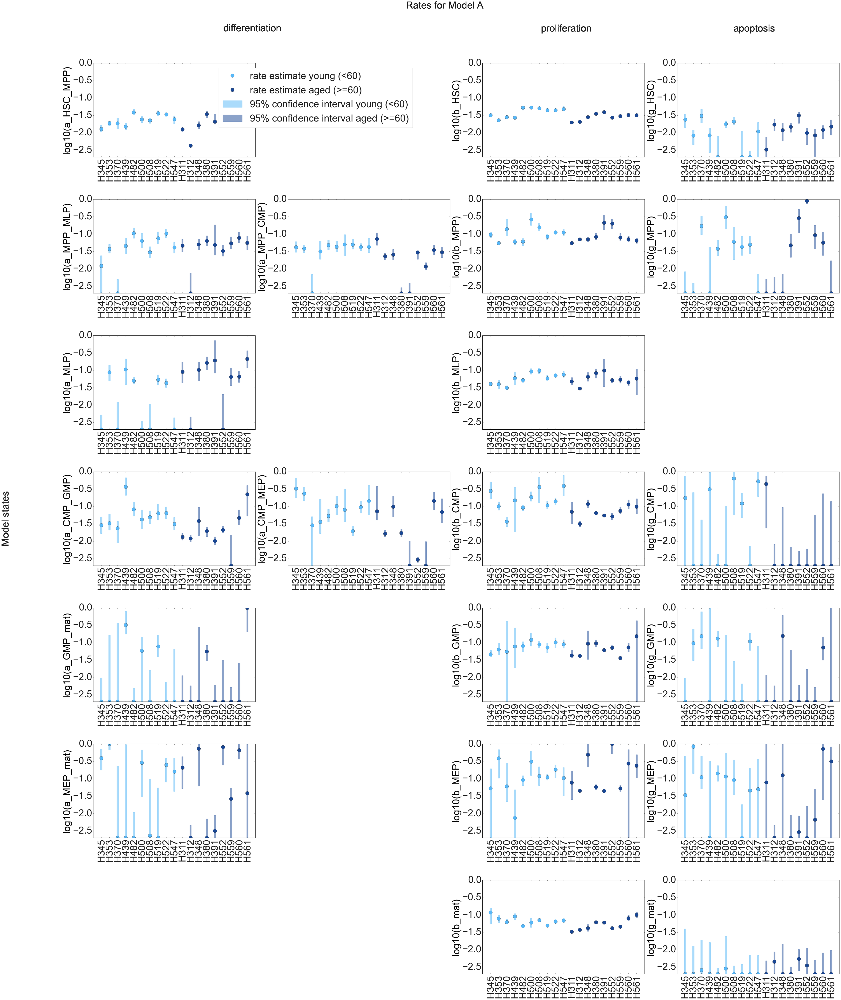

In [59]:
#par_T = 'lin'
par_T = 'log10'
rot_deg = 90
opt_comparison = 'H_young_vs_H_aged'
bool_test_par = False
colors = cols_H_y_vs_H_a 
alpha_errorband = 0.01
#alpha_errorband = 0.05
plot_par_with_CI_vs_individuals(matlab_dir_str, folder_str_H_MDS, subfolder_str_H_MDS, subsubfolder_str_H_MDS, last_subsubfolder_str, samples_excluded_H, samples_excluded_MDS, M_names_sim, M_names_opt, CT, par_T, colors, opt_comparison, rot_deg, opt_sample_ID,bool_fit_repetitions_seperately,False,alpha_errorband,opt_save)

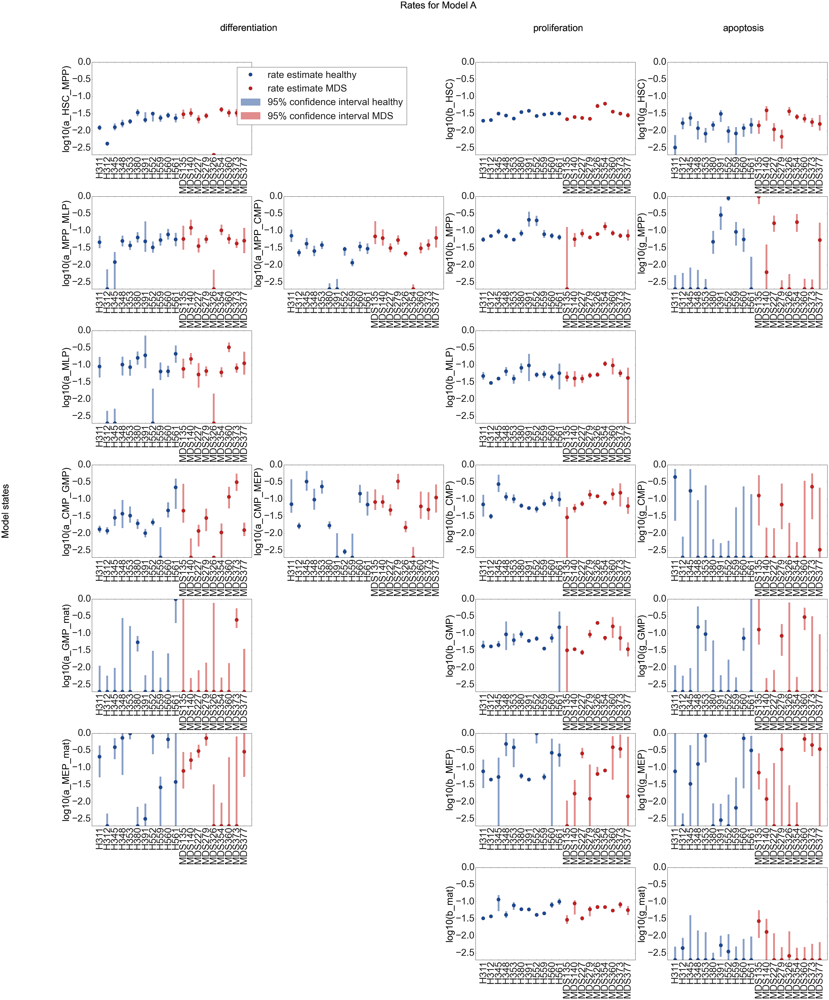

In [60]:
#par_T = 'lin'
par_T = 'log10'
rot_deg = 90
opt_comparison = 'H_age_matched_vs_MDS'
colors = cols_H_vs_MDS 
bool_test_par = False
#alpha_errorband = 0.01
alpha_errorband = 0.05
plot_par_with_CI_vs_individuals(matlab_dir_str, folder_str_H_MDS, subfolder_str_H_MDS, subsubfolder_str_H_MDS, last_subsubfolder_str, samples_excluded_H, samples_excluded_MDS, M_names_sim, M_names_opt, CT, par_T, colors, opt_comparison, rot_deg, opt_sample_ID,bool_fit_repetitions_seperately,False,alpha_errorband,opt_save)

### Model fits

In [22]:
plt = loadPltSettings(30,10)

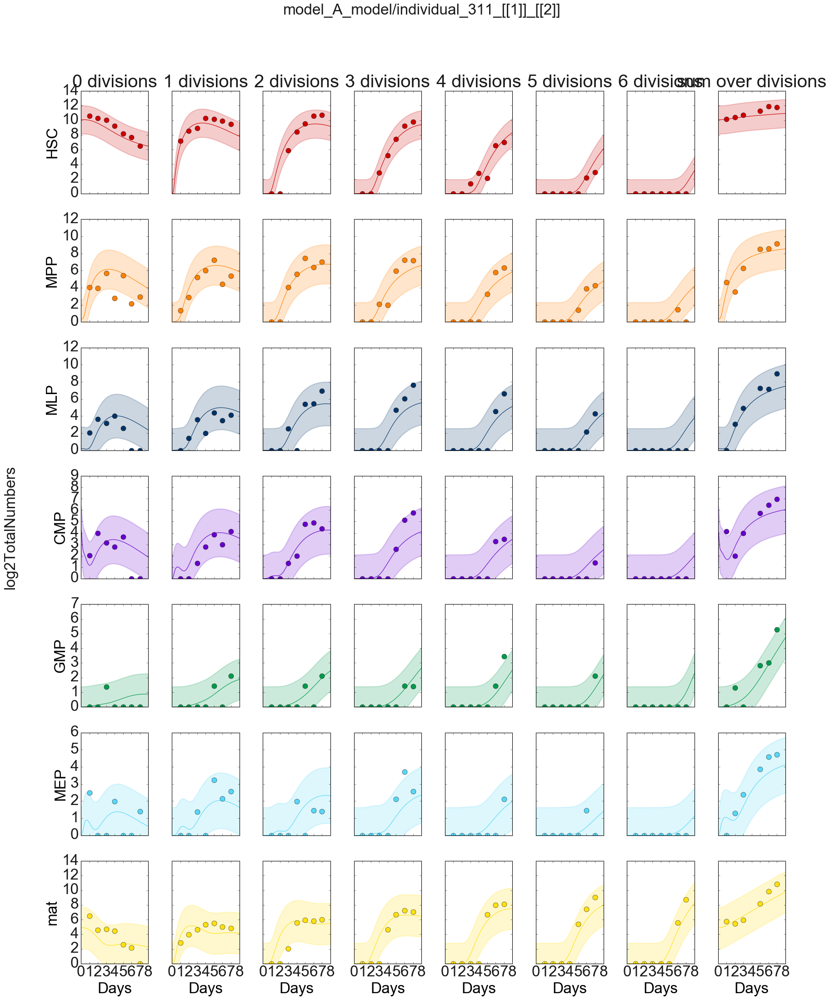

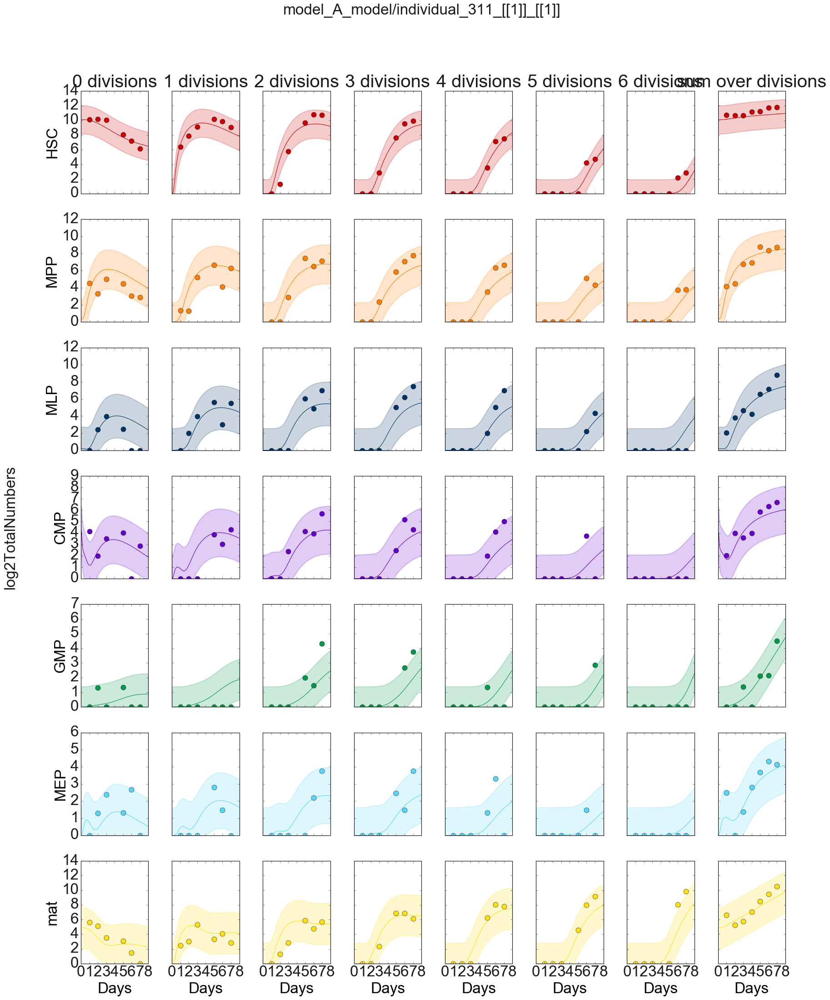

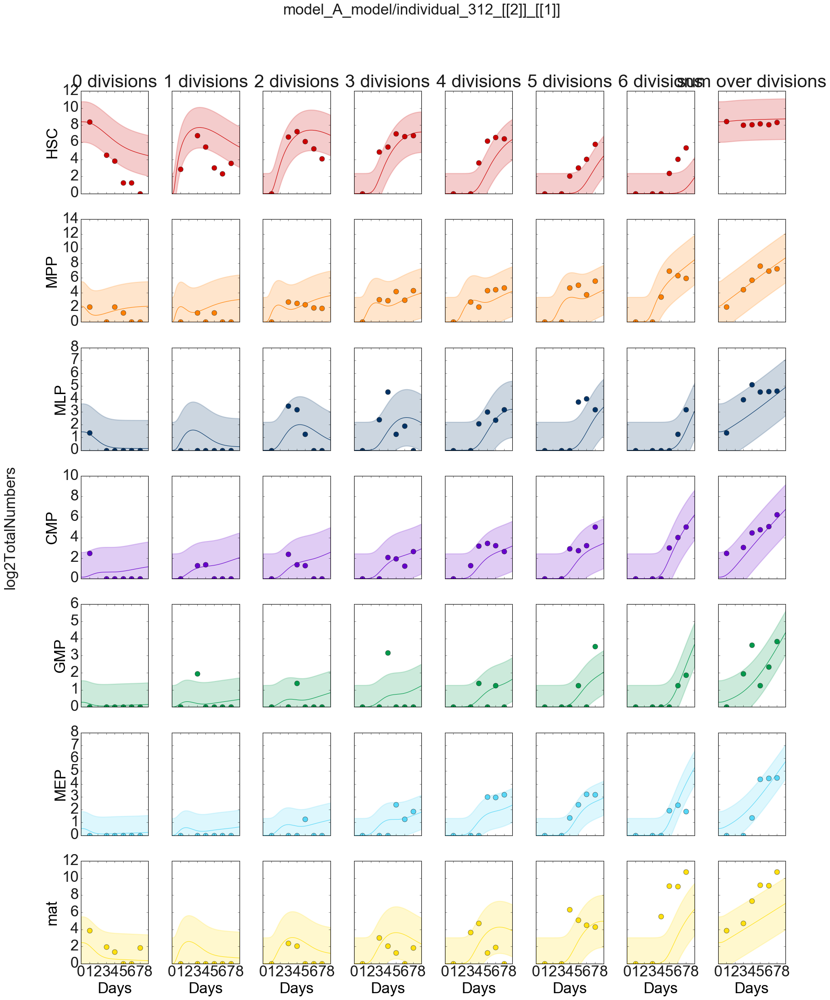

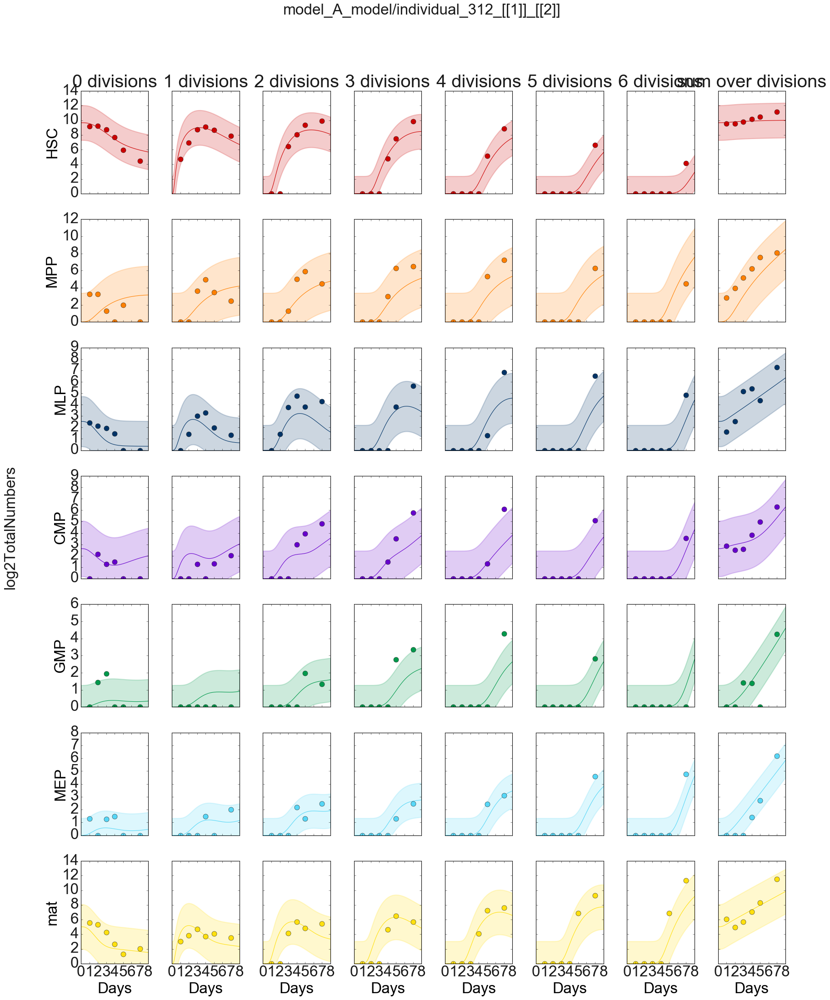

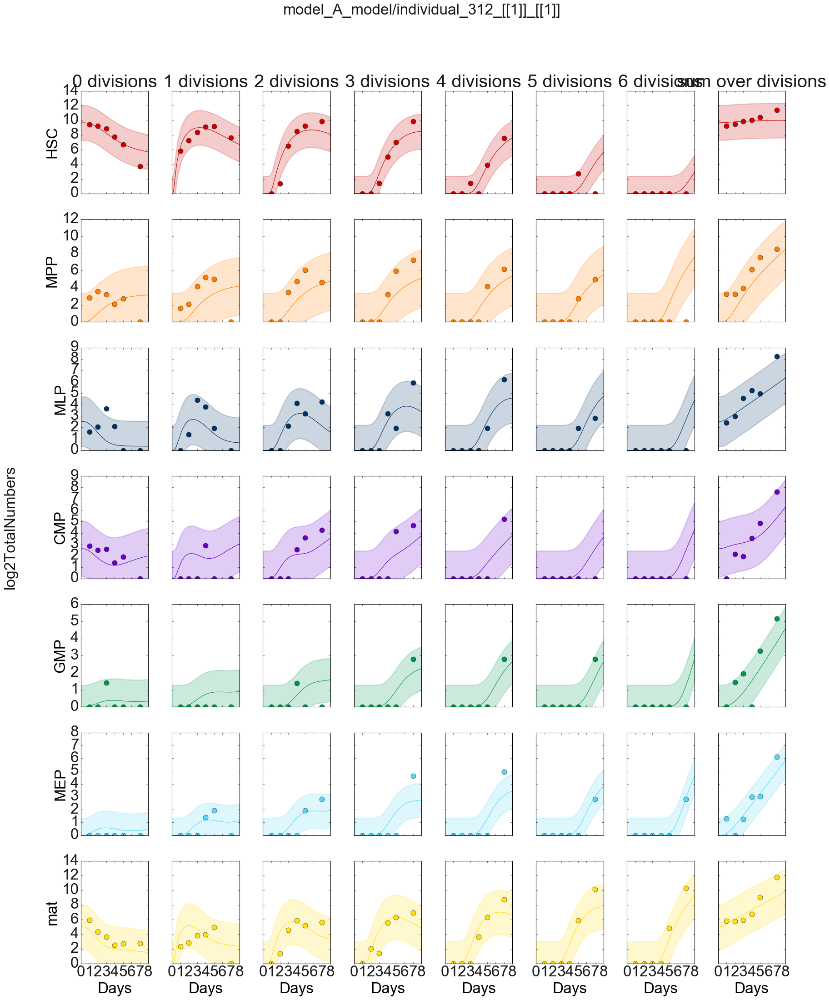

...

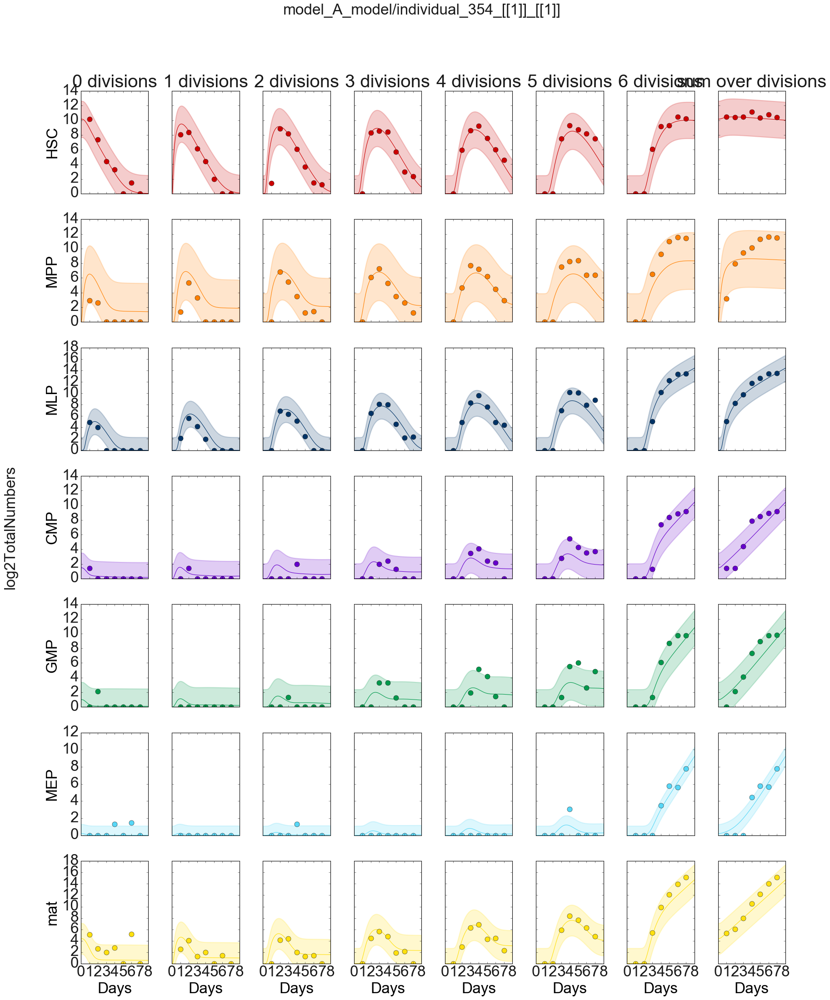

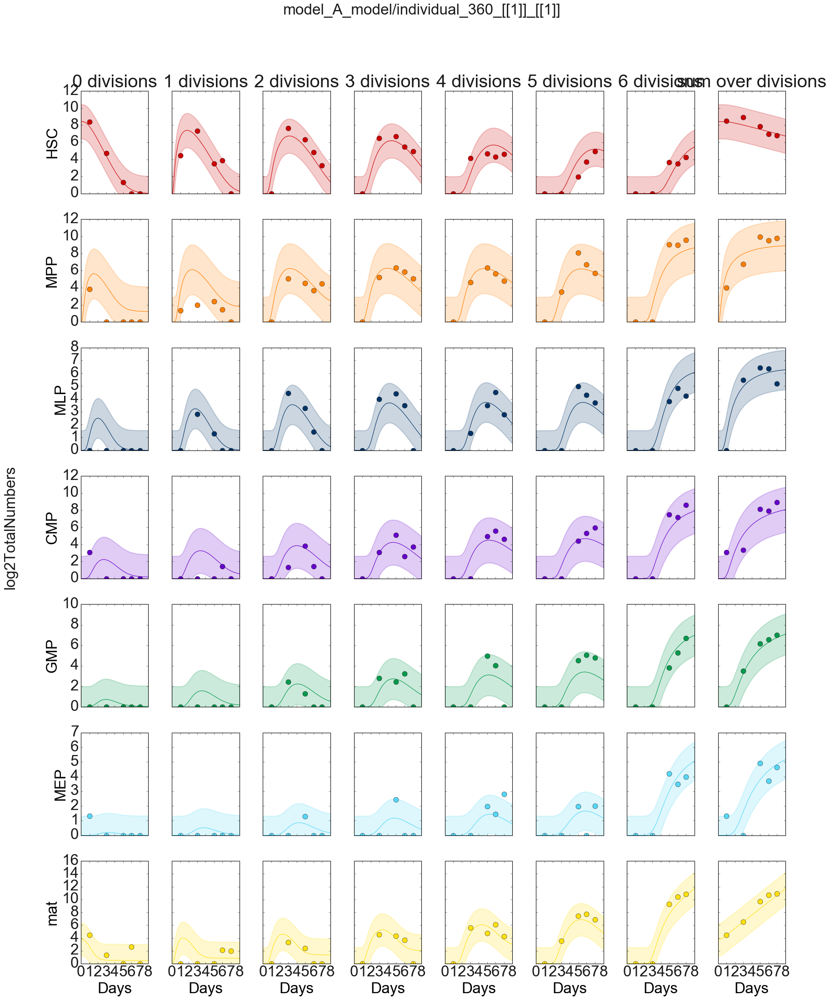

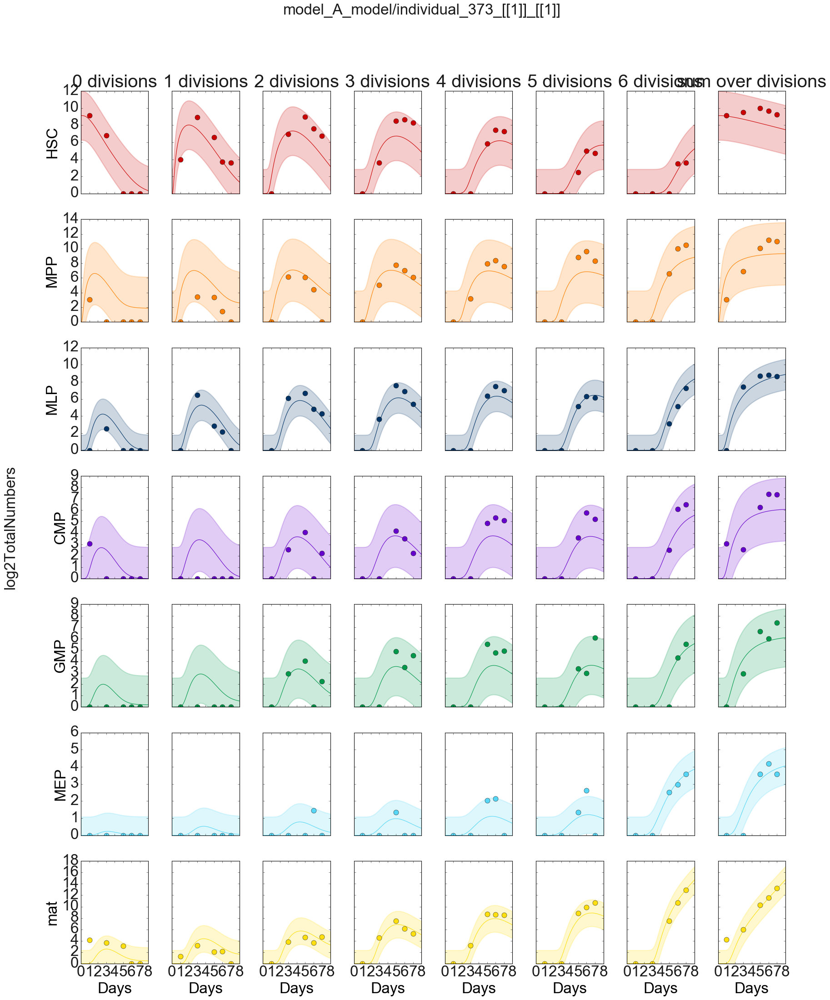

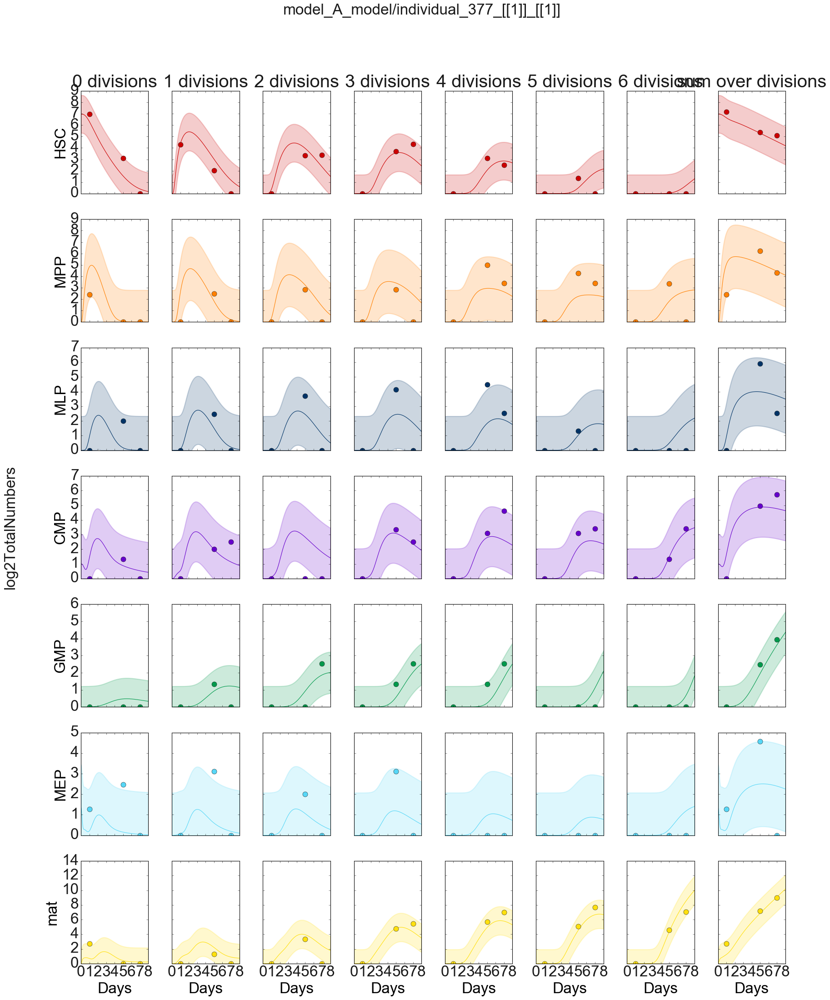

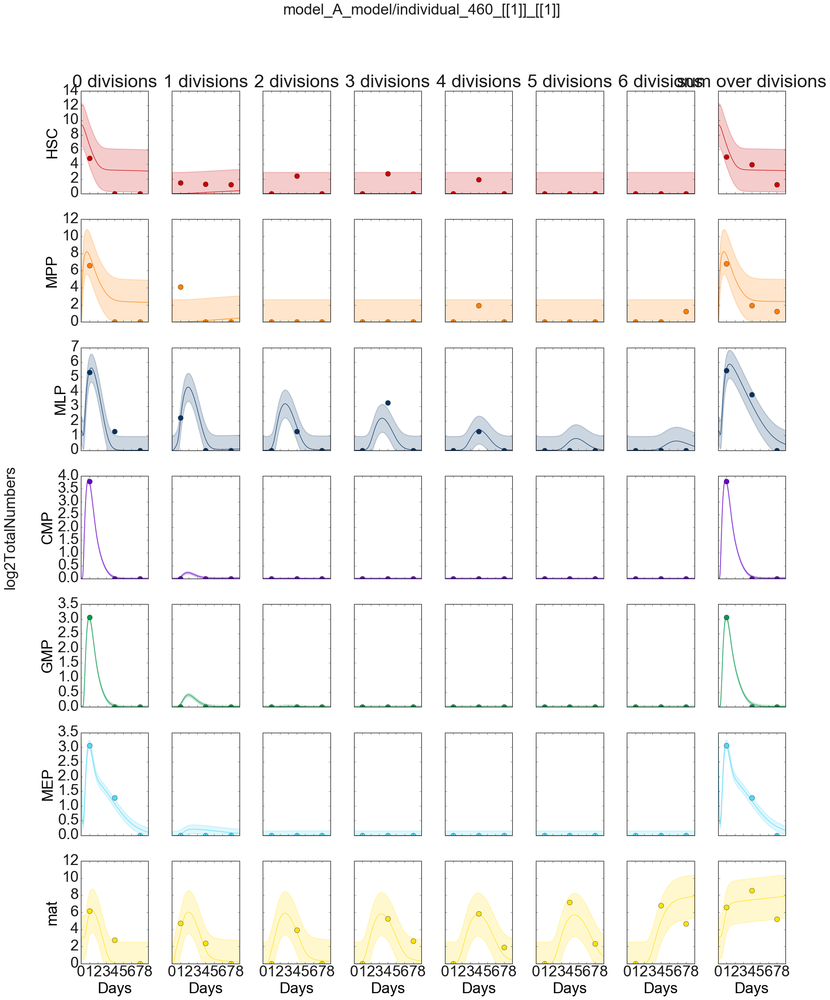

In [23]:
plotModelFitToData(dir_str,folder_str_H_MDS,subfolder_str_H_MDS,subsubfolder_str_H_MDS,CT,cols_CT,False,opt_save)

### Map parameter estimates of all individuals to patient data

In [12]:
model_of_interest = 'model_A'
subfolder_str_H_MDS = []
subfolder_str_H_MDS.append(model_of_interest+"_model/")
M_names_opt = list(model_of_interest[len(model_of_interest)-1])
opt_mutations_of_interest = 'combined'
bool_identifiablePars_only=True

#### load data frames

In [13]:
os.chdir(dir_str)
#os.getcwd()
%run 'defined_functions.ipynb'

In [14]:
mutations_of_interest_str = ''
opt_mutations_of_interest = 'all'
df_PD = load_patient_data_frame(samples_excluded_H,samples_excluded_MDS,opt_mutations_of_interest,opt_sample_ID,dir_str)
#len(df_PD['Sample_ID'].unique())

/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:24: FutureWarning: The 'get_values' method is deprecated and will be removed in a future version. Use '.to_numpy()' or '.array' instead.
/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:26: FutureWarning: The 'get_values' method is deprecated and will be removed in a future version. Use '.values' or 'np.asarray(..)' instead.
/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:27: RuntimeWarning: invalid value encountered in greater


In [15]:
#df_PD[['Sample_ID','Mutation_counts']]

In [16]:
df_PD.head()

,Sample_ID,year_of_birth,acquisition_date_of_the_BM_sample,age,sex,karyotype,dysplasia_erythropoiesis,sideroblasts,dysplastic_granulopoiesis,dysplastic_megakaryopoiesis,...,IDH2_S_VAF,GATA1_S_VAF,TP53_S_VAF,STAG2_S_VAF,WT1_S_VAF,KRAS_S_VAF,NFE2_S_VAF,Mutation_counts,number_data_points,weight_data
0,MDS135,1939,23.06.14,77,m,46 XY [20],yes,>15%,yes,yes,...,NaN,NaN,NaN,NaN,NaN,NaN,0,0,4,0.021978
1,MDS360,1963,22.03.17,54,m,46 XY [20],yes,>15%,yes,yes,...,0,0,0,0,0,0,0,2,5,0.027473
2,MDS227,1947,28.09.15,68,f,46 XX [20],yes,30%,yes,yes,...,0,0,0,0,0,0,0,2,7,0.038462
3,MDS373,1957,26.04.17,60,m,46 XY [20],yes,yes,yes,yes,...,0,0,0,0,0,0,0,3,5,0.027473
4,MDS377,1953,10.05.17,64,f,45 XX -7 [20],yes,no,no,yes,...,NaN,NaN,NaN,NaN,NaN,NaN,0,0,3,0.016484


#### get parameter result per sample for particular model & merge patient data frame and parameter results data frame

In [17]:
#get parameter result data frame
par_T = 'lin' 
bool_with_weights = True
bool_identifiablePars_only = False#True#
bool_test_par=False
bool_CIs = True
bool_boundaries=False
path_matlab_result=dir_str + folder_str_H_MDS[0] + subfolder_str_H_MDS[0] 

df_PAR = get_par_estimates(path_matlab_result, last_subsubfolder_str, M_names_opt, CT, par_T, bool_identifiablePars_only,bool_with_weights,bool_test_par,bool_CIs,bool_boundaries,bool_fit_repetitions_seperately)

#merge the two data frames
if bool_fit_repetitions_seperately:
    DF = pd.merge(df_PAR,df_PD, on='Sample_ID_long', how='inner')
    opt_sample_ID = 'long'
else:
    DF = pd.merge(df_PAR,df_PD, on='Sample_ID', how='inner')
    opt_sample_ID = 'short'
ratenames = DF.columns[np.logical_and(np.logical_and(np.logical_and(np.logical_or(np.logical_or(DF.columns.str.startswith('a_'),DF.columns.str.startswith('b_')),DF.columns.str.startswith('g_')),DF.columns.str.endswith('_w_CI')==False),DF.columns.str.endswith('_CI_l')==False),DF.columns.str.endswith('CI_u')==False)]


In [18]:
DF.head(5)

,Model,Sample_ID_long,Sample_ID,a_HSC_MPP,a_HSC_MPP_CI_l,a_HSC_MPP_CI_u,a_HSC_MPP_w_CI,b_HSC,b_HSC_CI_l,b_HSC_CI_u,...,IDH2_S_VAF,GATA1_S_VAF,TP53_S_VAF,STAG2_S_VAF,WT1_S_VAF,KRAS_S_VAF,NFE2_S_VAF,Mutation_counts,number_data_points,weight_data
0,model_A,H311,H311,0.012525,0.010609,0.014711,0.080403,0.019718,0.018663,0.020891,...,0,0,0,0,0,0,0,0,13,0.071429
1,model_A,H312,H312,0.004239,0.003746,0.004788,0.316490,0.020706,0.019304,0.022489,...,0,0,0,0,0,0,0,0,18,0.098901
2,model_A,H345,H345,0.012807,0.010415,0.016384,0.055246,0.031816,0.028536,0.035751,...,0,0,0,0,0,0,0,1,6,0.032967
3,model_A,H348,H348,0.016276,0.012908,0.020997,0.040766,0.027904,0.025225,0.031059,...,0,0,0,0,0,0,25,2,7,0.038462
4,model_A,H353,H353,0.018866,0.016208,0.022031,0.056635,0.022851,0.021228,0.024907,...,0,0,0,0,0,0,0,0,7,0.038462


### significant differences in rates between ASXL1 mutated vs non-mutated MDS patients?

In [19]:
R_ASXL1_pos = DF[np.logical_and(DF['Sample_ID_long'].str.startswith('MDS'), DF['ASXL1']!='no')]['a_HSC_MPP']
R_ASXL1_neg = DF[np.logical_and(DF['Sample_ID_long'].str.startswith('MDS'), DF['ASXL1']=='no')]['a_HSC_MPP']

In [20]:
stats.mannwhitneyu(R_ASXL1_pos, R_ASXL1_neg, alternative='greater')

MannwhitneyuResult(statistic=14.0, pvalue=0.1956336396413197)

In [21]:
#plt.plot([0,0,0,0,0],R_ASXL1_pos,'*r')
#plt.plot([1,1,1,1],R_ASXL1_neg,'*b')

In [22]:
ratenames

Index(['a_HSC_MPP', 'b_HSC', 'g_HSC', 'a_MPP_MLP', 'a_MPP_CMP', 'b_MPP',
       'g_MPP', 'a_MLP', 'b_MLP', 'a_CMP_GMP', 'a_CMP_MEP', 'b_CMP', 'g_CMP',
       'a_GMP_mat', 'b_GMP', 'g_GMP', 'a_MEP_mat', 'b_MEP', 'g_MEP', 'b_mat',
       'g_mat'],
      dtype='object')

#### mean weighted parameter healthy age-matched in [h]

In [23]:
#calculate weights
for r_id,rate in enumerate(ratenames):
    DF[rate+'_w'] = (DF[rate+'_w_CI']+DF['weight_data'])/2

In [24]:
DF.head(5)

,Model,Sample_ID_long,Sample_ID,a_HSC_MPP,a_HSC_MPP_CI_l,a_HSC_MPP_CI_u,a_HSC_MPP_w_CI,b_HSC,b_HSC_CI_l,b_HSC_CI_u,...,b_CMP_w,g_CMP_w,a_GMP_mat_w,b_GMP_w,g_GMP_w,a_MEP_mat_w,b_MEP_w,g_MEP_w,b_mat_w,g_mat_w
0,model_A,H311,H311,0.012525,0.010609,0.014711,0.080403,0.019718,0.018663,0.020891,...,0.045539,0.036132,0.059042,0.066560,0.071015,0.037123,0.044262,0.036292,0.099385,0.068814
1,model_A,H312,H312,0.004239,0.003746,0.004788,0.316490,0.020706,0.019304,0.022489,...,0.143101,0.099695,0.106906,0.133482,0.138961,0.260783,0.187011,0.273141,0.100576,0.063449
2,model_A,H345,H345,0.012807,0.010415,0.016384,0.055246,0.031816,0.028536,0.035751,...,0.019333,0.016894,0.044393,0.052684,0.061007,0.017492,0.022862,0.017774,0.020237,0.018943
3,model_A,H348,H348,0.016276,0.012908,0.020997,0.040766,0.027904,0.025225,0.031059,...,0.034715,0.022577,0.020024,0.023233,0.019798,0.019809,0.020817,0.019808,0.039434,0.026889
4,model_A,H353,H353,0.018866,0.016208,0.022031,0.056635,0.022851,0.021228,0.024907,...,0.036031,0.020454,0.020585,0.033323,0.020820,0.020869,0.021311,0.019903,0.029200,0.027930


In [25]:
#get dataframes sorted by group comparison H age matched vs. MDS
DF, DF_H, DF_CHIP, DF_MDS, lab_str1, lab_str2, lab_str3 = get_dataframe_selection(DF,'H_age_matched_vs_CHIP_age_matched_vs_MDS',opt_sample_ID)

/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:36: FutureWarning: The 'get_values' method is deprecated and will be removed in a future version. Use '.values' or 'np.asarray(..)' instead.
/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in greater
/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:37: FutureWarning: The 'get_values' method is deprecated and will be removed in a future version. Use '.values' or 'np.asarray(..)' instead.
/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: invalid value encountered in greater


In [26]:
#weighted mean and std of weighted mean group healthy age matched:
par_mean_w_H = [0]*len(ratenames)
par_std_w_H = [0]*len(ratenames)
for r_id,rate in enumerate(ratenames):
    weighted_stats_H = DescrStatsW(DF_H[rate], weights=DF_H[rate+'_w'], ddof=0)
    par_mean_w_H[r_id] = weighted_stats_H.mean
    par_std_w_H[r_id] = weighted_stats_H.std    

In [27]:
DF_weighted_mean_and_std_H = pd.DataFrame({'rate':ratenames,'weighted mean healthy age-matched':par_mean_w_H,'std of weighted mean healthy age-matched':par_std_w_H})
DF_weighted_mean_and_std_H

,rate,weighted mean healthy age-matched,std of weighted mean healthy age-matched
0,a_HSC_MPP,0.011244,0.008976
1,b_HSC,0.023602,0.005163
2,g_HSC,0.010162,0.005444
3,a_MPP_MLP,0.025444,0.024077
4,a_MPP_CMP,0.015992,0.021292
5,b_MPP,0.065803,0.010756
6,g_MPP,0.008146,0.021030
7,a_MLP,0.040962,0.050130
8,b_MLP,0.041682,0.014761
9,a_CMP_GMP,0.013637,0.007416


#### HSC cell cycle length for MDS326 and MDS354

In [28]:
p_id = ['MDS326','MDS354']
for i in range(0,2):
    print('cell cyle length '+p_id[i]+':'+str(1/DF[DF['Sample_ID']==p_id[i]]['b_HSC'].get_values())+' and 95% confidence interval: '+ str(1/DF[DF['Sample_ID']==p_id[i]]['b_HSC_CI_u'].get_values()) + ',' + str(1/DF[DF['Sample_ID']==p_id[i]]['b_HSC_CI_l'].get_values()))

cell cyle length MDS326:[18.7754] and 95% confidence interval: [16.3448],[21.2413]
cell cyle length MDS354:[16.0825] and 95% confidence interval: [14.9533],[17.0585]


/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: The 'get_values' method is deprecated and will be removed in a future version. Use '.to_numpy()' or '.array' instead.
  This is separate from the ipykernel package so we can avoid doing imports until


### Age vs parameter estimates

In [29]:
par_T = 'lin' 
bool_CIs = True
bool_with_weights = False
bool_identifiablePars_only = False#True#
bool_test_par=False
df_PAR = get_par_estimates(path_matlab_result, last_subsubfolder_str, M_names_opt, CT, par_T, bool_identifiablePars_only,bool_with_weights,bool_test_par,bool_CIs,bool_boundaries,bool_fit_repetitions_seperately)
#merge data frames
if bool_fit_repetitions_seperately:
    DF = pd.merge(df_PAR,df_PD, on='Sample_ID_long', how='inner')
else:
    DF = pd.merge(df_PAR,df_PD, on='Sample_ID', how='inner')
ratenames = DF.columns[np.logical_and(np.logical_or(np.logical_or(DF.columns.str.startswith('a_'),DF.columns.str.startswith('b_')),DF.columns.str.startswith('g_')),DF.columns.str.endswith('_w')==False)]


In [30]:
bool_per_day = True
bool_plot_IDs = False
ratenames = DF.columns[np.logical_and(np.logical_and(np.logical_and(np.logical_or(np.logical_or(DF.columns.str.startswith('a_'),DF.columns.str.startswith('b_')),DF.columns.str.startswith('g_')),DF.columns.str.endswith('_w_CI')==False),DF.columns.str.endswith('_CI_l')==False),DF.columns.str.endswith('CI_u')==False)]
if bool_per_day and par_T=='ratio':
    DF_day = DF.copy()
    DF_day[ratenames] = DF[ratenames]

In [31]:
#1/DF[DF['age']==79]['b_HSC']
#bool_identifiablePars_only
plt = loadPltSettings(30,40)

In [44]:
os.chdir(dir_str)
#os.getcwd()
%run 'defined_functions.ipynb'

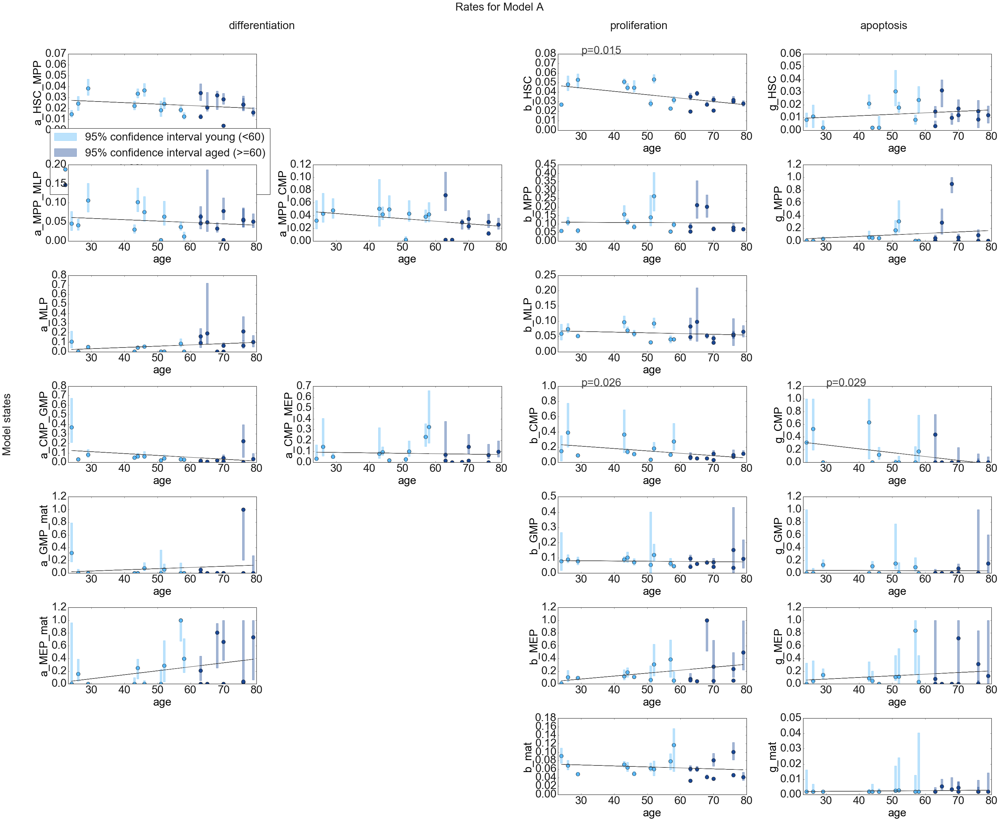

In [48]:
opt_comparison = 'H_young_vs_H_aged_with_CHIP'
opt_plot_CIs = True
opt_single_regressionLine = True
opt_log_transform_rates = False #True # if set to True individual rates are first transformed such that normal assumption holds
plot_par_vs_age(DF,dir_str, par_T, folder_str_H_MDS, subfolder_str_H_MDS, model_of_interest, CT, ratenames,cols_H_y_vs_H_a ,opt_comparison,opt_single_regressionLine,bool_plot_IDs,opt_sample_ID,opt_log_transform_rates,opt_plot_CIs,opt_save)

/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: The 'get_values' method is deprecated and will be removed in a future version. Use '.values' or 'np.asarray(..)' instead.
/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:22: RuntimeWarning: invalid value encountered in greater
/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The 'get_values' method is deprecated and will be removed in a future version. Use '.values' or 'np.asarray(..)' instead.
/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in greater


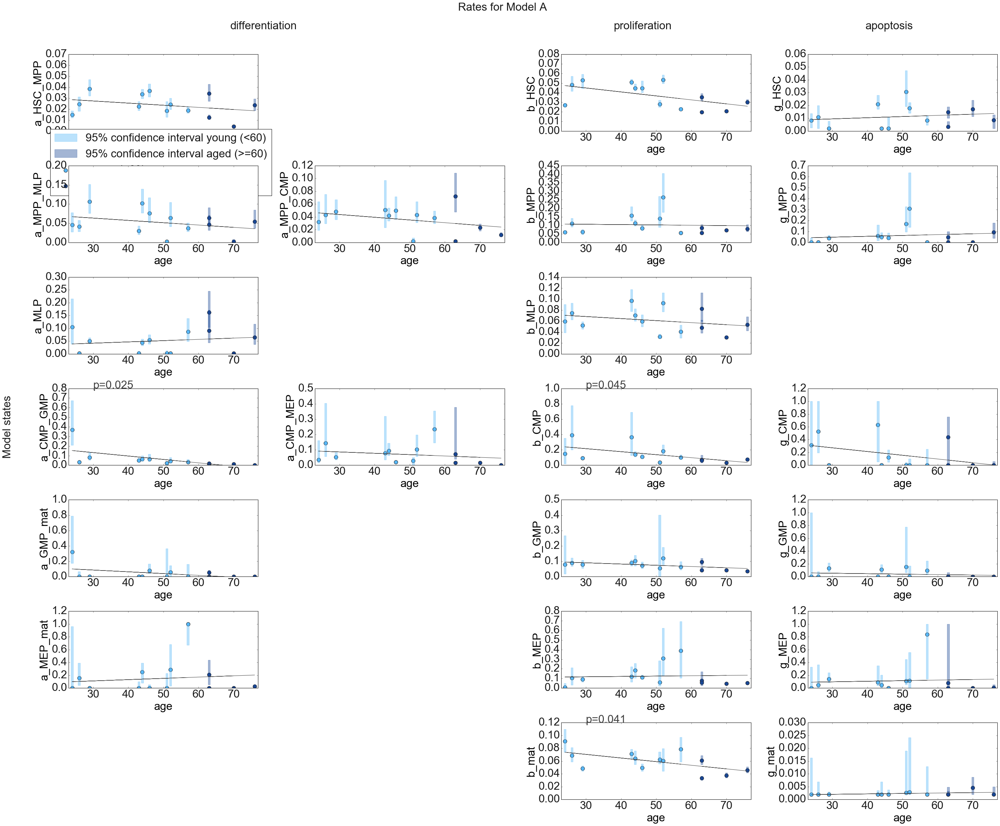

In [49]:
opt_comparison = 'H_young_vs_H_aged_without_CHIP'
opt_single_regressionLine = True
opt_log_transform_rates = False #True # if set to True individual rates are first transformed such that normal assumption holds
plot_par_vs_age(DF,dir_str, par_T, folder_str_H_MDS, subfolder_str_H_MDS, model_of_interest, CT, ratenames,cols_H_y_vs_H_a ,opt_comparison,opt_single_regressionLine,bool_plot_IDs,opt_sample_ID,opt_log_transform_rates,opt_plot_CIs,opt_save)

In [57]:
#j=list(range(1,22))
#t = [1/i for i in j]
#alpha=0.05
#TH = [alpha* k/(np.sum(t)*21) for k in j]
#TH

### Metrics plots

In [58]:
bool_identifiablePars_only=False
bool_with_weights=False
bool_test_par=False
bool_CIs=False
bool_boundaries=False
par_T = 'lin'
path_matlab_result=dir_str + folder_str_H_MDS[0] + subfolder_str_H_MDS[0] 
df_PAR = get_par_estimates(path_matlab_result, last_subsubfolder_str, M_names_opt, CT, par_T, bool_identifiablePars_only,bool_with_weights,bool_test_par,bool_CIs,bool_boundaries,bool_fit_repetitions_seperately)

if opt_sample_ID=='long':
    I_col = 'Sample_ID_long'
elif opt_sample_ID=='short':
    I_col = 'Sample_ID'
    
DF = pd.merge(df_PAR,df_PD, on=I_col, how='inner')

#add metrics as columns to dataframe
DF = addMetrics2dataframe(DF,par_T,CT)

In [59]:
#DF.columns[DF.columns.str.endswith('ration')]

In [60]:
#DF[(DF['Sample_ID'].str.startswith('H')) & (DF['MEP_cellular_exit_time'].get_values()<8)][['Sample_ID','MEP_cellular_exit_time','age']]

In [61]:
#DF[(DF['Sample_ID'].str.startswith('H')) & (DF['MEP_cellular_exit_time'].get_values()>=8)][['Sample_ID','MEP_cellular_exit_time','age']]

In [62]:
#comp = 'HSC'
#DF[DF['Sample_ID'].str.startswith('H')][comp+'_cellular_exit_time'].mean()

In [63]:
#DF[['Sample_ID','CMP_net_proliferation','age']]

In [64]:
#DF[['HSC_net_proliferation','Sample_ID']][DF['Sample_ID'].str.startswith('MDS')]

In [65]:
#DF['MEP_net_proliferation'][DF['Sample_ID']=='MDS326']

In [66]:
plt = loadPltSettings(20,50)

0.028595223106828882
0.018668207960331428
0.03869430557100332


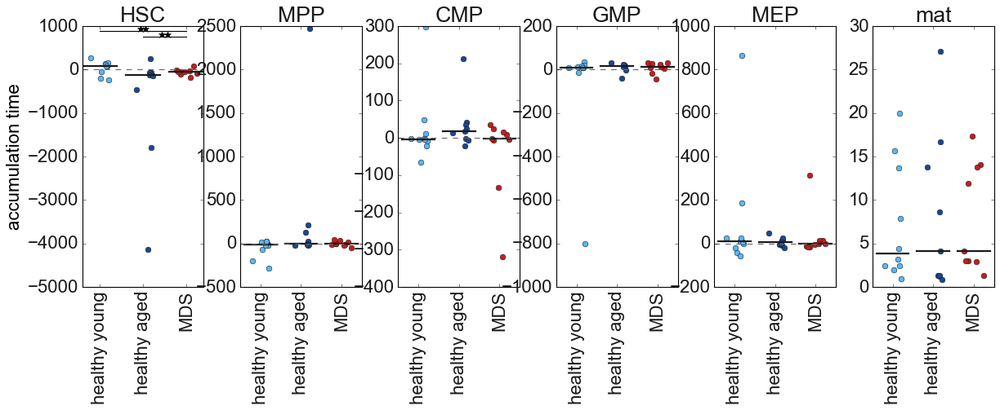

In [67]:
bool_interrupt_axis=False#True#
metric_str = '_accumulation_time'
CT_list = ['HSC','MPP','CMP','GMP','MEP','mat']
MS=6
plot_metricComparison(path_matlab_result,DF,metric_str,CT_list,bool_interrupt_axis,MS,opt_save)

In [68]:
plt = loadPltSettings(15,40)

0.06361894303201669
0.41912824319291314
0.02113005304197832
0.05475733171938819
0.012372336023199468
0.23996434607297862


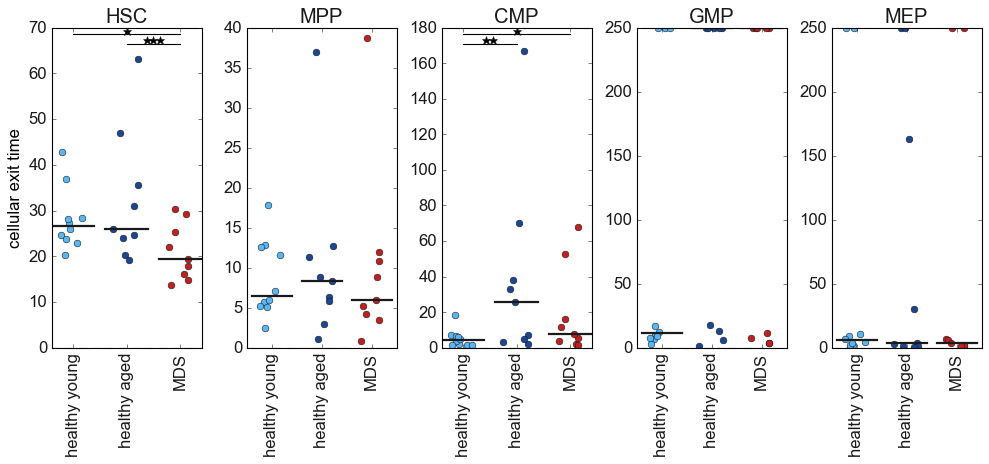

In [69]:
metric_str = '_cellular_exit_time'
bool_interrupt_axis=False#True#
CT_list = ['HSC','MPP','CMP','GMP','MEP']
MS=6
plot_metricComparison(path_matlab_result,DF,metric_str,CT_list,bool_interrupt_axis,MS,opt_save)

In [70]:
DF['HSC_net_proliferation'][DF['Sample_ID_long'].str.startswith('MDS')]

19    0.007532
20   -0.014103
21    0.012939
22    0.015752
23    0.015800
24    0.036440
25    0.013817
26    0.013680
27    0.012614
Name: HSC_net_proliferation, dtype: float64

In [71]:
DF['HSC_cellular_exit_time'][DF['Sample_ID']=='MDS354']

24    14.754074
Name: HSC_cellular_exit_time, dtype: float64

In [72]:
DF['HSC_cellular_exit_time'][DF['Sample_ID']=='MDS326']

23    25.341446
Name: HSC_cellular_exit_time, dtype: float64

In [73]:
DF['HSC_cellular_exit_time'][DF['Sample_ID']=='H312']

1    47.026971
Name: HSC_cellular_exit_time, dtype: float64

In [74]:
DF['HSC_cellular_exit_time'][DF['Sample_ID']=='H391']

7    19.091777
Name: HSC_cellular_exit_time, dtype: float64

In [75]:
plt = loadPltSettings(20,80)

0.061908251389823726


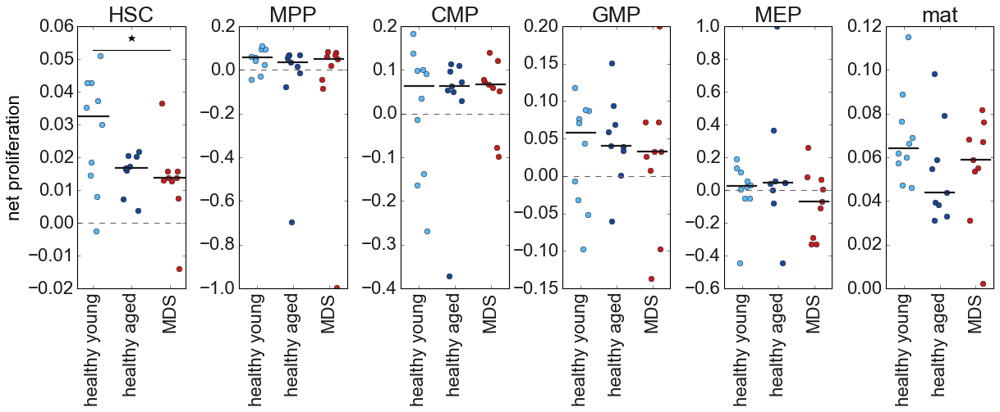

In [76]:
bool_interrupt_axis=False#True#
metric_str = '_net_proliferation'
CT_list = ['HSC','MPP','CMP','GMP','MEP','mat']
MS=6
plot_metricComparison(path_matlab_result,DF,metric_str,CT_list,bool_interrupt_axis,MS,opt_save)

#### median compartment-specific net proliferation and cellular exit time

In [77]:
print('median compartment-specific net proliferation and cellular exit time: ')
print('MPP net proliferation: '+ str((DF[DF['Sample_ID_long'].str.startswith('H')]['MPP_net_proliferation']*24).median()))
print('HSC net proliferation: '+ str((DF[DF['Sample_ID_long'].str.startswith('H')]['HSC_net_proliferation']*24).median()))
print('MPP cellular exit time: '+ str((DF[DF['Sample_ID_long'].str.startswith('H')]['MPP_cellular_exit_time']*24).median()))
print('HSC cellular exit time: '+ str((DF[DF['Sample_ID_long'].str.startswith('H')]['HSC_cellular_exit_time']*24).median()))

median compartment-specific net proliferation and cellular exit time: 
MPP net proliferation: 1.2845234702782027
HSC net proliferation: 0.4456312682553107
MPP cellular exit time: 170.00063530726857
HSC cellular exit time: 623.6024753196073


In [78]:
if opt_sample_ID=='long':
    I_col = 'Sample_ID_long'
elif opt_sample_ID=='short':
    I_col = 'Sample_ID'

In [79]:
par_T = 'lin'
path_matlab_result=dir_str + folder_str_H_MDS[0] + subfolder_str_H_MDS[0] 
df_PAR = get_par_estimates(path_matlab_result, last_subsubfolder_str, M_names_opt, CT, par_T, bool_identifiablePars_only,bool_with_weights,bool_test_par,bool_CIs,bool_boundaries,bool_fit_repetitions_seperately)

if opt_sample_ID=='long':
    I_col = 'Sample_ID_long'
elif opt_sample_ID=='short':
    I_col = 'Sample_ID'
    
DF = pd.merge(df_PAR,df_PD, on=I_col, how='inner')

#add metrics as columns to dataframe
DF = addMetrics2dataframe(DF,par_T,CT)

DF_H_y = DF[(DF[I_col].str.startswith('H')) & (DF['age']<60)].copy()
DF_H_a = DF[(DF[I_col].str.startswith('H')) & (DF['age']>=60)].copy()
DF_MDS = DF[DF[I_col].str.startswith('MDS')].copy()

In [80]:
DF_MDS[DF_MDS['Sample_ID_long']=='MDS326']['HSC_net_proliferation']

23    0.0158
Name: HSC_net_proliferation, dtype: float64

In [81]:
DF_MDS[DF_MDS['Sample_ID_long']=='MDS326']['HSC_cellular_exit_time']

23    25.341446
Name: HSC_cellular_exit_time, dtype: float64

In [82]:
DF_MDS[DF_MDS['Sample_ID_long']=='MDS326']

,Model,Sample_ID_long,Sample_ID,a_HSC_MPP,b_HSC,g_HSC,a_MPP_MLP,a_MPP_CMP,b_MPP,g_MPP,...,GMP_cellular_exit_time,GMP_accumulation_time,MEP_log_effective_proliferation_rate,MEP_net_proliferation,MEP_cellular_exit_time,MEP_accumulation_time,mat_log_effective_proliferation_rate,mat_net_proliferation,mat_cellular_exit_time,mat_accumulation_time
23,model_A,MDS326,MDS326,0.002,0.053261,0.037461,0.002,0.021792,0.081244,0.002,...,250.0,5.012198,3.483734,0.063162,250.0,13.121386,3.265707,0.067193,375.019024,14.046339


In [83]:
1/DF_H_y['a_HSC_MPP']

2     78.084618
4     53.005375
5     53.900350
8     66.915332
9     26.033595
10    41.117197
11    44.502594
12    27.346440
13    29.746707
14    41.012993
Name: a_HSC_MPP, dtype: float64

In [84]:
1/DF_H_a['a_HSC_MPP']

0      79.838511
1     235.893576
3      61.438431
6      29.193756
7      47.921852
15     31.250028
16     42.076991
17     35.055992
18     42.529981
Name: a_HSC_MPP, dtype: float64

In [85]:
1/DF_MDS['a_HSC_MPP']

19     32.450029
20     30.354071
21     45.488274
22     36.387077
23    500.000000
24     23.787600
25     29.608474
26     29.958100
27     21.669518
Name: a_HSC_MPP, dtype: float64

### PCA of parameter estimates
idea: find the directions of maximum variance in high-dimensional data (parameter estimates) and project it onto a smaller dimensional subspace while retaining most of the information
- PCA is a linear transofrmation method
- PCA yields the directions (principal components) that maximize the variance of the data
- PCA projects the entire dataset onto a different feature (sub)space
- PCA "ignores" class labels
- the eigenvectors (principal components) determine the directions of the new feature space, and the eigenvalues determine their magnitude --> the eigenvalues explain the variance of the data along the new feature axes
- if some eigenvalues have a significantly larger magnitude than others, the reduction of the dataset via PCA onto a smaller dimensional subspace by dropping the "less informative" eigenpairs is reasonable

### weighted PCA: if more data points were available and CIs are small we trust parameter results more --> higher weights fo these observations

In [698]:
#get parameter result data frame
par_T='lin'
bool_with_weights = True#False#
bool_identifiablePars_only = False
opt_features = 'rates'
#opt_features = 'metrics'

path_matlab_result=dir_str + folder_str_H_MDS[0] + subfolder_str_H_MDS[0] 
df_PAR = get_par_estimates(path_matlab_result, last_subsubfolder_str, M_names_opt, CT, par_T, bool_identifiablePars_only,bool_with_weights,False,False,False,bool_fit_repetitions_seperately)

if opt_sample_ID=='long':
    I_col = 'Sample_ID_long'
elif opt_sample_ID=='short':
    I_col = 'Sample_ID'
#merge data frames
DF = pd.merge(df_PAR,df_PD, on=I_col, how='inner')

#calculate weights
for r_id,rate in enumerate(ratenames):
    DF[rate+'_w'] = (DF[rate+'_w_CI']+DF['weight_data'])/2
    
if opt_features == 'rates':
    ratenames = DF.columns[np.logical_and(np.logical_and(np.logical_and(np.logical_and(np.logical_or(np.logical_or(DF.columns.str.startswith('a_'),DF.columns.str.startswith('b_')),DF.columns.str.startswith('g_')),DF.columns.str.endswith('_w_CI')==False),DF.columns.str.endswith('_CI_l')==False),DF.columns.str.endswith('CI_u')==False),DF.columns.str.endswith('_w')==False)]            
#    ratenames = DF.columns[np.logical_and(np.logical_or(np.logical_or(DF.columns.str.startswith('a_'),DF.columns.str.startswith('b_')),DF.columns.str.startswith('g_')),DF.columns.str.endswith('_w')==False)]            
    weightnames = DF.columns[np.logical_and(np.logical_or(np.logical_or(DF.columns.str.startswith('a_'),DF.columns.str.startswith('b_')),DF.columns.str.startswith('g_')),DF.columns.str.endswith('_w'))]
elif opt_features == 'metrics':
    #add metrics as columns to dataframe
    DF = addMetrics2dataframe(DF,par_T,CT)
    ratenames = DF.columns[np.logical_or(DF.columns.str.endswith('_cellular_exit_time'),DF.columns.str.endswith('_net_proliferation'))]


In [699]:
bool_PCA_based_on_MDS_only = True#
bool_only_age_matched = True#False#
bool_only_nonCHIP = False #True
n_comps = len(ratenames)

if bool_only_age_matched:
    min_age_MDS = np.min(DF[DF['Sample_ID_long'].str.startswith('MDS')]['age'])
    DF = DF[(DF['age']>=min_age_MDS)].copy()
    DF.reset_index(inplace=True,drop=True)

mutation_str = DF.columns[DF.columns.str.endswith('VAF')]

X_all = DF[ratenames].copy()
X_all_std = StandardScaler().fit_transform(X_all)
if bool_with_weights:
    W_all = getWeightDataframe(DF[weightnames].copy(),DF['weight_data'].copy())

if bool_PCA_based_on_MDS_only:
    X_MDS = DF[ratenames][DF['Sample_ID_long'].str.startswith('MDS')].copy()
    #parameter:
    X = X_MDS
    #weights
    if bool_with_weights:
        W = getWeightDataframe(DF[weightnames][DF['Sample_ID_long'].str.startswith('MDS')].copy(), DF['weight_data'][DF['Sample_ID_long'].str.startswith('MDS')].copy())
    if bool_only_age_matched:
        if bool_only_nonCHIP:
            add_file_str = 'weighted_PCA_based on_MDS_compared2agematched_nonCHIP_individuals'
            X_H = DF[DF['Sample_ID_long'].str.startswith('H') & (np.any(DF[mutation_str].get_values().astype(np.float)>0,axis=1)==False)].copy()
            if bool_with_weights:
                W_H = getWeightDataframe(DF[weightnames][DF['Sample_ID_long'].str.startswith('H') & (np.any(DF[mutation_str].get_values().astype(np.float)>0,axis=1)==False)].copy(),DF['weight_data'][DF['Sample_ID_long'].str.startswith('H') & (np.any(DF[mutation_str].get_values().astype(np.float)>0,axis=1)==False)].copy())
        else:
            add_file_str = 'weighted_PCA_based on_MDS_compared2agematched_individuals'
            X_H = DF[DF['Sample_ID_long'].str.startswith('H')].copy()
            if bool_with_weights:
                W_H = getWeightDataframe(DF[weightnames][DF['Sample_ID_long'].str.startswith('H')].copy(),DF['weight_data'][DF['Sample_ID_long'].str.startswith('H')].copy())
    else:
        add_file_str = 'weighted_PCA_based on_MDS_compared2all_individuals'
        X_H_y = DF[ratenames][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']<60)].copy()
        X_H_a = DF[ratenames][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']>=60)].copy()
        if bool_with_weights:
            W_H_y = getWeightDataframe(DF[weightnames][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']<60)].copy(),DF['weight_data'][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']<60)].copy())
            W_H_a = getWeightDataframe(DF[weightnames][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']>=60)].copy(),DF['weight_data'][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']>=60)].copy())
else:
    if bool_only_age_matched:
        add_file_str = 'weighted_PCA_based_on_MDS_and_agematched_individuals'
        X_H = DF[ratenames][DF['Sample_ID_long'].str.startswith('H')].copy()
        if bool_with_weights:
            W_H = getWeightDataframe(DF[weightnames][DF['Sample_ID_long'].str.startswith('H')].copy(),DF['weight_data'][DF['Sample_ID_long'].str.startswith('H')].copy())
    else:
        add_file_str = 'weighted_PCA_based_on_all_individuals'
        X_H_y = DF[ratenames][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']<60)].copy()
        X_H_a = DF[ratenames][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']>=60)].copy()
        if bool_with_weights:
            W_H_y = getWeightDataframe(DF[weightnames][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']<60)].copy(),DF['weight_data'][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']<60)].copy())
            W_H_a = getWeightDataframe(DF[weightnames][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']>=60)].copy(),DF['weight_data'][(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']>=60)].copy())
    #parameter:
    X = DF[ratenames].copy()
    #weights
    if bool_with_weights:
        W = getWeightDataframe(DF[weightnames].copy(),DF['weight_data'].copy())

X_std = StandardScaler().fit_transform(X)
n_individuals,n_features = np.shape(X)#is updated later

In [700]:
# want features to have mean=0 and variance=1
print('mean: '+str(np.mean(X_std,axis=0)))
print('var: '+str(np.var(X_std,axis=0)))

mean: [-2.4672e-16  2.5905e-16  2.3438e-16  4.3792e-16  2.4672e-17 -1.4543e-16
  1.8504e-17  6.7847e-17 -7.4015e-17  4.9343e-17 -6.1679e-17 -2.4672e-17
  3.7007e-17  0.0000e+00 -7.4015e-17  0.0000e+00 -3.7007e-17 -1.4803e-16
 -2.4672e-17  2.4672e-17  8.6351e-17]
var: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]


In [701]:
if bool_with_weights:
    opt_weighted_PCA = True
else:
    opt_weighted_PCA = False
if opt_weighted_PCA:
    mean_vec = np.mean(np.multiply(np.array(W),np.array(X_std)),axis=0)/np.sum(np.array(W),axis=0)
    cov_mat = np.divide((np.multiply(np.matrix(W),np.matrix(X_std))).T*(np.multiply(np.matrix(W),np.matrix(X_std))),(np.matrix(W).T * np.matrix(W)))
else:
    mean_vec = np.mean(X_std, axis=0)
    cov_mat = (X_std - mean_vec).T.dot((X_std - mean_vec)) / (X_std.shape[0]-1) #or: np.cov(X_std.T)

In [702]:
eig_vals, eig_vecs = np.linalg.eig(cov_mat)

In [703]:
#eig_vals

In [704]:
#np.shape(cov_mat)

In [705]:
#np.shape(eig_vecs)

In [706]:
#u,s,v = np.linalg.svd(X_std)

In [707]:
for ev in eig_vecs:
    np.testing.assert_array_almost_equal(1.0, np.linalg.norm(ev))
print('Everything ok!')

Everything ok!


In [708]:
# Make a list of (eigenvalue, eigenvector) tuples
eig_pairs = [(np.abs(eig_vals[i]), eig_vecs[:,i]) for i in range(len(eig_vals))]

# Sort the (eigenvalue, eigenvector) tuples from high to low
eig_pairs.sort()
eig_pairs.reverse()

# Visually confirm that the list is correctly sorted by decreasing eigenvalues
#print('Eigenvalues in descending order:')
#for i in eig_pairs:
#    print(i[0])

In [709]:
#eig_pairs[0][1][1]

In [710]:
plt = loadPltSettings(20,7)

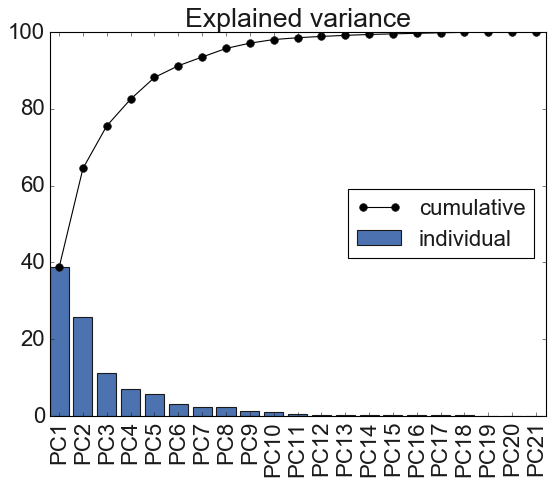

In [711]:
tot = sum(abs(eig_vals[0:n_comps]))
var_exp = [(i / tot)*100 for i in sorted(abs(eig_vals[0:n_comps]), reverse=True)]
cum_var_exp = np.cumsum(var_exp)
var_exp
plot_explained_variance(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,var_exp,'all_pars',opt_save)

Here, we are reducing the 21-dimensional feature space to a 2-dimensional feature subspace, by choosing the "top 2" eigenvectors with the highest eigenvalues to construct our 𝑑×𝑘-dimensional eigenvector matrix 𝐖.

In [712]:
n_features = len(ratenames)
matrix_w = []
for i in range(0,n_comps):
    matrix_w.append(eig_pairs[i][1].reshape(n_features,1))
matrix_w = np.hstack(matrix_w)
#eigenvectors belonging to highest n_comps eigenvalues


#matrix_w = np.hstack((eig_pairs_red[0][1][0:n_comps].reshape(n_comps,1), 
#                      eig_pairs_red[1][1][0:n_comps].reshape(n_comps,1)))
#eigenvectors belonging to highest 2 eigenvalues
np.shape(matrix_w)

(21, 21)

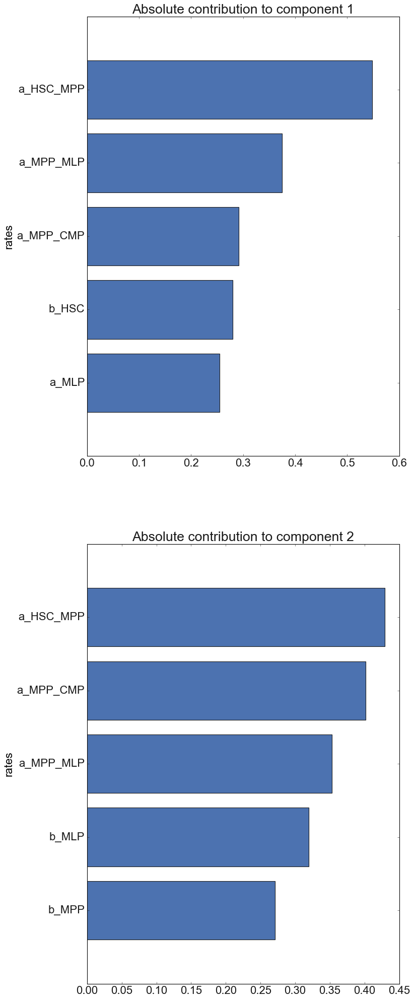

In [713]:
components = np.asarray(matrix_w.T)
method_str = 'PCA'
n_pars=5
plot_contribution2components(dir_str,folder_str_H_MDS, subfolder_str_H_MDS, components, 2,n_pars,ratenames,add_file_str,method_str,'',opt_save)

projection onto the new feature space: we will use the 21×2-dimensional projection matrix 𝐖 to transform our samples onto the new subspace via the equation
𝐘=𝐗×𝐖, where 𝐘 is a 31×2 matrix of our transformed samples.

In [714]:
opt_weighted_Ellipse=False
W_H_1 = np.array([])
W_H_2 = np.array([])
Y = X_all_std.dot(matrix_w)

In [715]:
#np.shape(Y)

In [716]:
#Y[DF['Sample_ID_long'].str.startswith('MDS'),:]

In [717]:
if bool_PCA_based_on_MDS_only:
    Y_MDS = Y[DF['Sample_ID_long'].str.startswith('MDS'),:]
if bool_only_age_matched:# 1 ellipse
    #ellipse only based on non-CHIP:
    mutation_str = DF.columns[DF.columns.str.endswith('VAF')]
    Y_H_2 = Y[DF['Sample_ID_long'].str.startswith('H') & (np.any(DF[mutation_str].get_values().astype(np.float)>0,axis=1)==False),:]
    Y_H_1 = []
    #else:
    #    Y_H_2 = Y[DF['Sample_ID_long'].str.startswith('H'),:]
    #    Y_H_1 = []
    if opt_weighted_Ellipse==True:
        W_H_2 = np.sum((np.resize(np.average(W_H,weights=abs(components[0]),axis=1),[np.shape(X_H)[0],1]),np.resize(np.average(W_H,weights=abs(components[1]),axis=1),[np.shape(X_H)[0],1])),axis=0)
else:
    if bool_only_nonCHIP:
        mutation_str = DF.columns[DF.columns.str.endswith('VAF')]
        Y_H_1 = Y[(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']<60) & (np.any(DF[mutation_str].get_values().astype(np.float)>0,axis=1)==False),:]
        Y_H_2 = Y[(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']>=60) & (np.any(DF[mutation_str].get_values().astype(np.float)>0,axis=1)==False),:]
    else:
        Y_H_1 = Y[(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']<60),:]
        Y_H_2 = Y[(DF['Sample_ID_long'].str.startswith('H')) & (DF['age']>=60),:]
    if opt_weighted_Ellipse:
        W_H_2 = np.sum((np.resize(np.average(W_H_a,weights=abs(components[0]),axis=1),[np.shape(X_H_a)[0],1]),np.resize(np.average(W_H_a,weights=abs(components[1]),axis=1),[np.shape(X_H_a)[0],1])),axis=0)
        W_H_1 = np.sum((np.resize(np.average(W_H_y,weights=abs(components[0]),axis=1),[np.shape(X_H_y)[0],1]),np.resize(np.average(W_H_y,weights=abs(components[1]),axis=1),[np.shape(X_H_y)[0],1])),axis=0)

/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: The 'get_values' method is deprecated and will be removed in a future version. Use '.values' or 'np.asarray(..)' instead.
  
/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in greater
  


In [718]:
np.shape(Y_H_2)

(5, 21)

In [719]:
bool_plotIDs =True# False #
legend_loc = "upper right"
IDX_PCs=[0,1]

In [720]:
plt = loadPltSettings(20,200)

In [721]:
os.chdir(dir_str)
#os.getcwd()
%run 'defined_functions.ipynb'

/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:28: FutureWarning: The 'get_values' method is deprecated and will be removed in a future version. Use '.values' or 'np.asarray(..)' instead.
/Users/lisa.bast/anaconda2/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:28: RuntimeWarning: invalid value encountered in greater


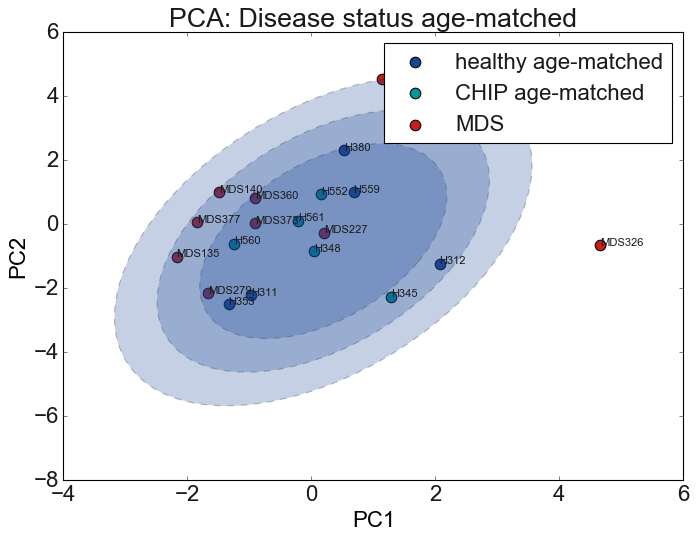

In [722]:
confidence_level = [0.65,0.85,0.95]
if bool_only_age_matched: 
    if bool_only_nonCHIP:
        #labels:
        comparison_str='Disease status age-matched non-CHIP'
        groups = ('healthy age-matched','MDS')
        groups_colors = [('healthy age-matched', col_H_a),('MDS', col_MDS)]
    else:
        #labels:
        comparison_str='Disease status age-matched'
        groups = ('healthy age-matched','CHIP age-matched','MDS')
        groups_colors = [('healthy age-matched', col_H_a),('CHIP age-matched', col_CHIP),('MDS', col_MDS)]
else:
    #labels:
    comparison_str='Disease status all'
    groups = ('Healthy young','Healthy aged','MDS')
    groups_colors = [('Healthy young', col_H_y),('Healthy aged', col_H_a),('MDS', col_MDS)]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)

In [723]:
Y_H_2[:,0:2]

matrix([[-0.9773, -2.2293],
        [ 2.0677, -1.2404],
        [-1.3367, -2.5056],
        [ 0.5235,  2.3127],
        [ 0.6806,  0.9907]])

In [724]:
S = np.empty_like(IDX_PCs)
M = np.empty_like(IDX_PCs)
for i,idx in enumerate(IDX_PCs):
    S[i] = np.std(Y_H_2[:,idx])
    M[i] = np.mean(Y_H_2[:,idx])
M

array([0, 0])

In [725]:
bool_plotIDs =False #

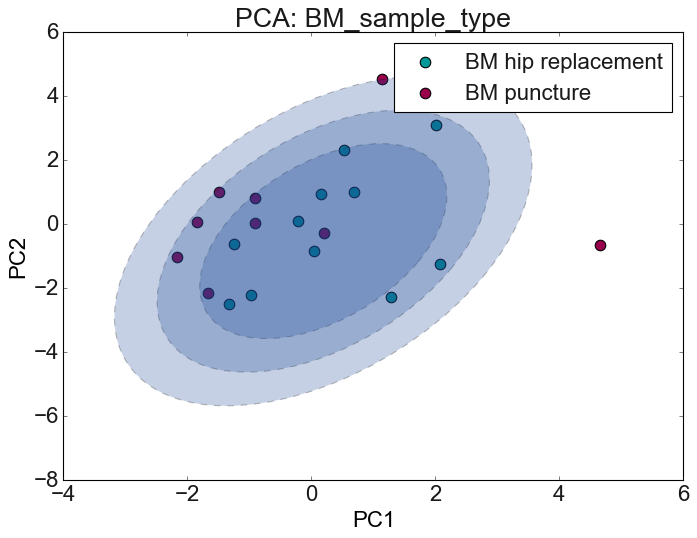

In [726]:
#labels:
comparison_str = 'BM_sample_type'
groups=DF['sample_type'].unique().tolist()
if len(groups)==2:  
    groups_colors=[(groups[0],'#009999'),(groups[1],'#99004C')]
else:
    groups_colors=[(groups[0],'#009999'),(groups[1],'#99004C'),(groups[2],'#CC6600')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)


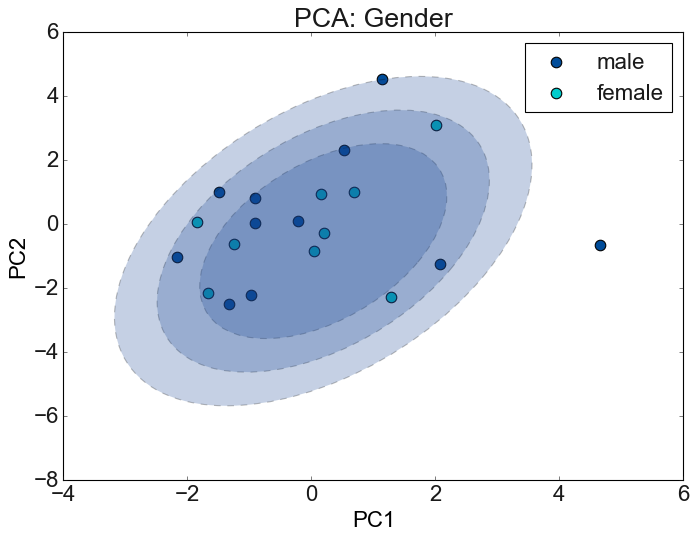

In [727]:
#labels:
comparison_str = 'Gender'
groups=('male','female')
groups_colors=[('male','#004C99'),('female','#00CCCC')]      
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)


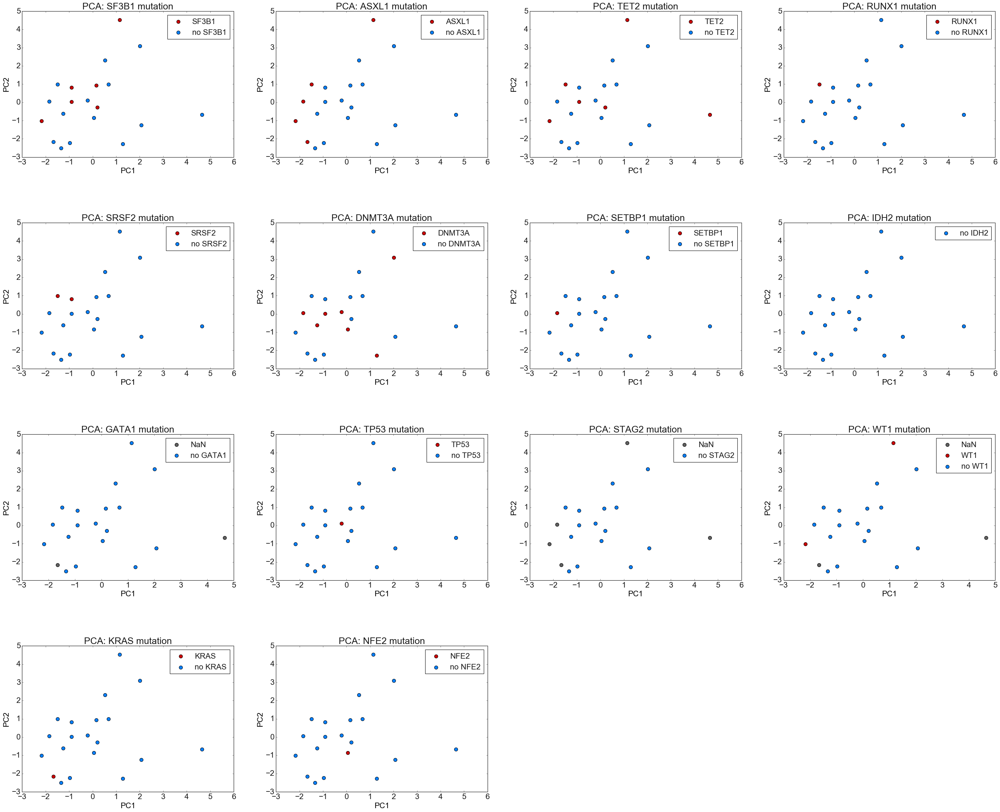

In [728]:
opt_mutation='combined'
FS=20
plot_PCA_2D_projection_allMutations(dir_str,folder_str_H_MDS,subfolder_str_H_MDS,DF,Y,Y_H_1,Y_H_2,opt_mutation,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,opt_sample_ID,W_H_1,W_H_2,confidence_level,opt_save)

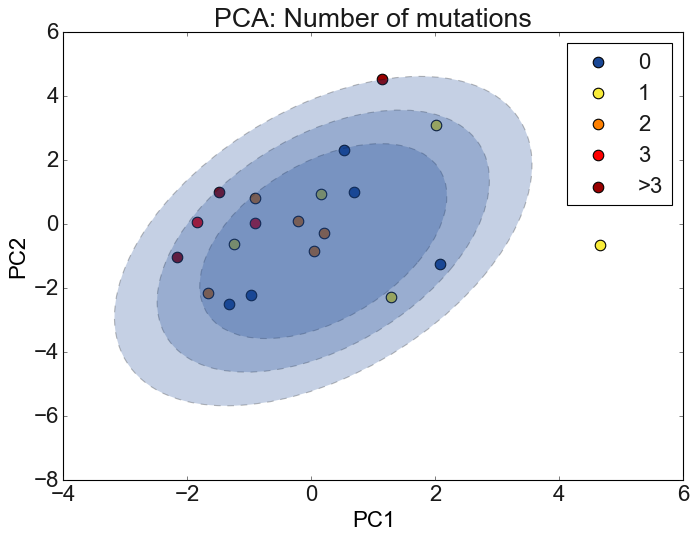

In [729]:
#labels:
comparison_str = 'Number of mutations'
groups=('0','1','2','3','>3')
groups_colors=[('0',col_H_a),('1','#F9EC39'),('2','#FF8000'),('3','#FF0000'),('>3','#990000')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)


In [730]:
#DF[['Sample_ID','Mutation_counts']]

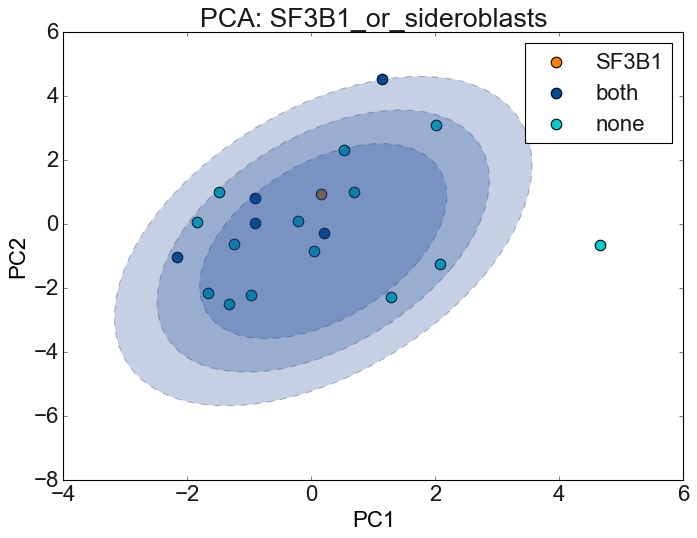

In [731]:
#labels:
comparison_str = 'SF3B1_or_sideroblasts'
groups=('SF3B1','sideroblasts','both','none')
groups_colors=[('SF3B1','#FF8000'),('sideroblasts','#FF0000'),('both','#004C99'),('none','#00CCCC')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)


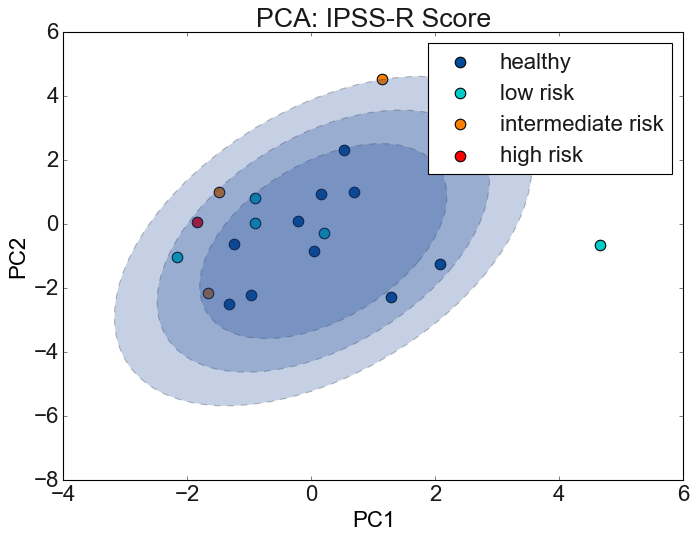

In [732]:
#labels:
comparison_str = 'IPSS-R Score'
groups=('healthy','low risk','intermediate risk','high risk','NaN')
groups_colors=[('healthy','#004C99'),('low risk','#00CCCC'),('intermediate risk','#FF8000'),('high risk','#FF0000'),('NaN','#808080')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)


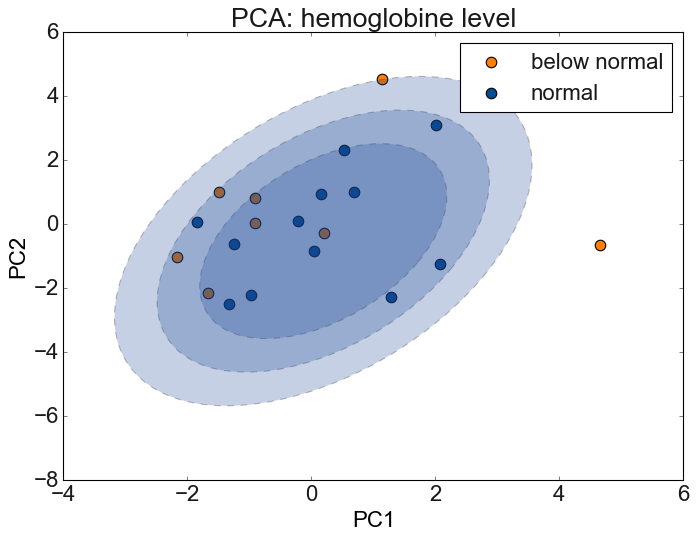

In [733]:
#labels:
comparison_str = 'hemoglobine level'
groups=('below normal','normal','increased')
groups_colors=[('below normal','#FF8000'),('normal','#004C99'),('increased','#CC0000')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)


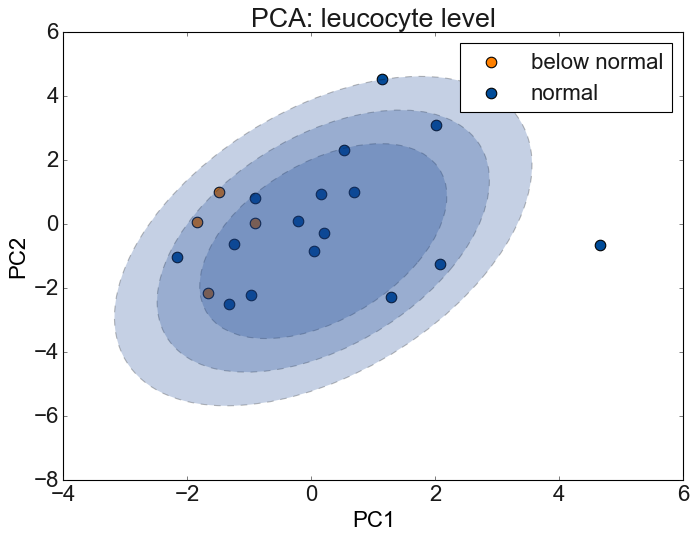

In [734]:
#labels:
comparison_str = 'leucocyte level'
groups=('below normal','normal','increased')
groups_colors=[('below normal','#FF8000'),('normal','#004C99'),('increased','#CC0000')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)


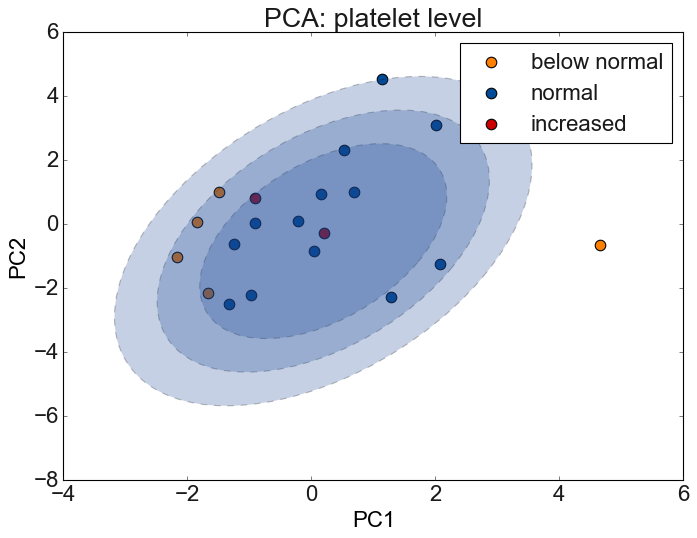

In [735]:
#labels:
comparison_str = 'platelet level'
groups=('below normal','normal','increased')
groups_colors=[('below normal','#FF8000'),('normal','#004C99'),('increased','#CC0000')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)

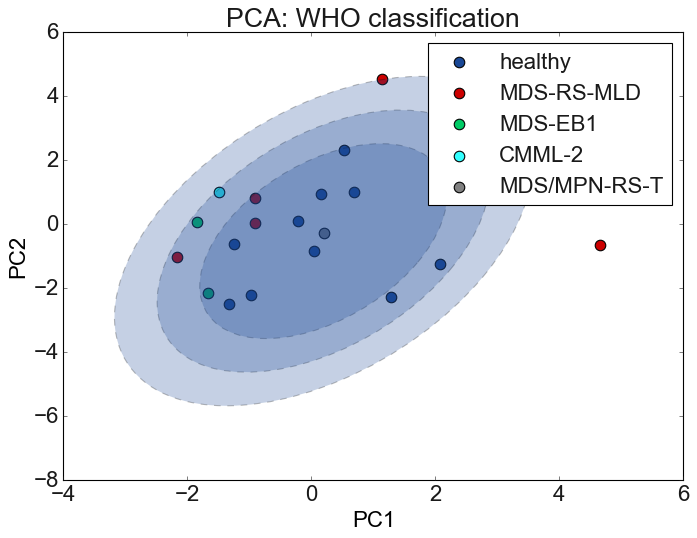

In [736]:
#labels:
comparison_str = 'WHO classification'
groups=('healthy','MDS-RS-MLD','MDS-EB1','MDS-EB2','CMML-2','MDS/MPN-RS-T')
groups_colors=[('healthy','#194795'),('MDS-RS-MLD','#CC0000'),('MDS-EB1','#00CC66'),('MDS-EB2','#FF8000'),('CMML-2','#33FFFF'),('MDS/MPN-RS-T','#808080')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)

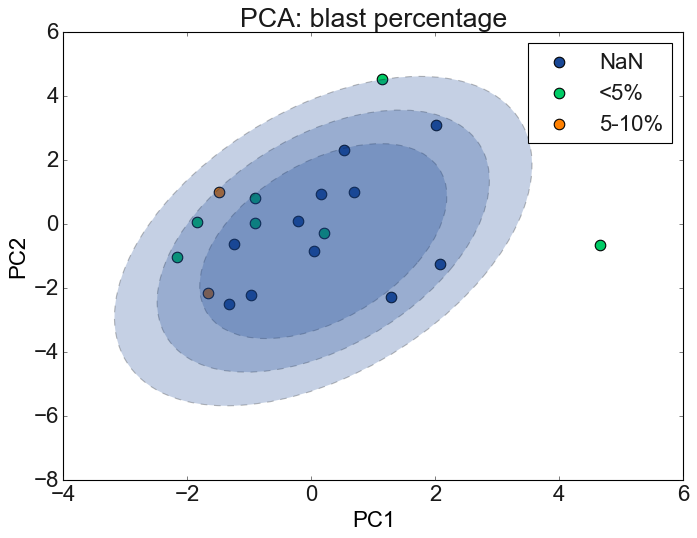

In [737]:
#labels:
comparison_str = 'blast percentage'
groups=('NaN','<5%','5-10%','>10%')
groups_colors=[('NaN','#194795'),('<5%','#00CC66'),('5-10%','#FF8000'),('>10%','#CC0000')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)

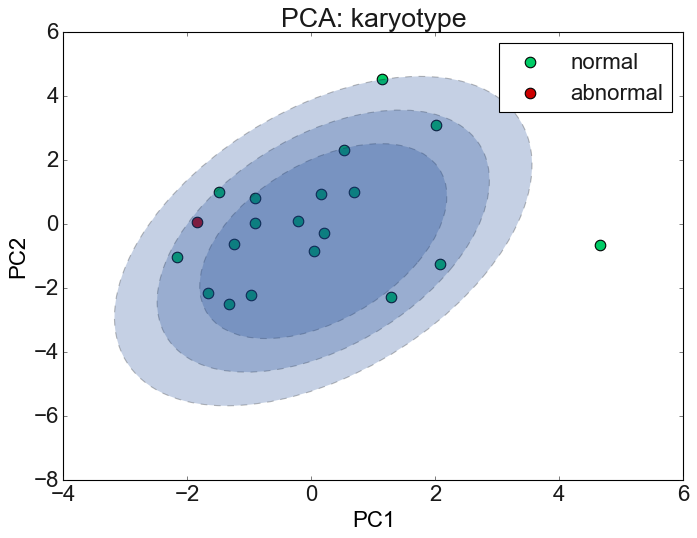

In [738]:
#labels:
comparison_str = 'karyotype'
groups=('normal','abnormal')
groups_colors=[('normal','#00CC66'),('abnormal','#CC0000')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)

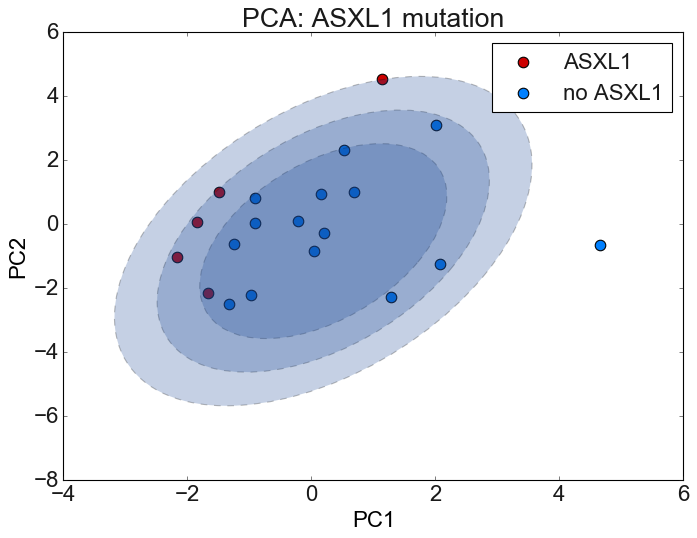

In [739]:
#for m_id in range(0,len(mutation_str)):
m_id=1
if opt_mutation == 'bulk':
    mut_ending = '_B'        
else:
    mut_ending = '_S'
mutation_str = df_PD.columns[df_PD.columns.str.endswith(mut_ending)]
if opt_mutation == 'combined':
    m_str = [mut_str[:-2] for mut_str in mutation_str]
    mutation_str = m_str
    
comparison_str, groups, groups_colors, y, s= get_mutation_labels(DF,mutation_str,m_id,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)

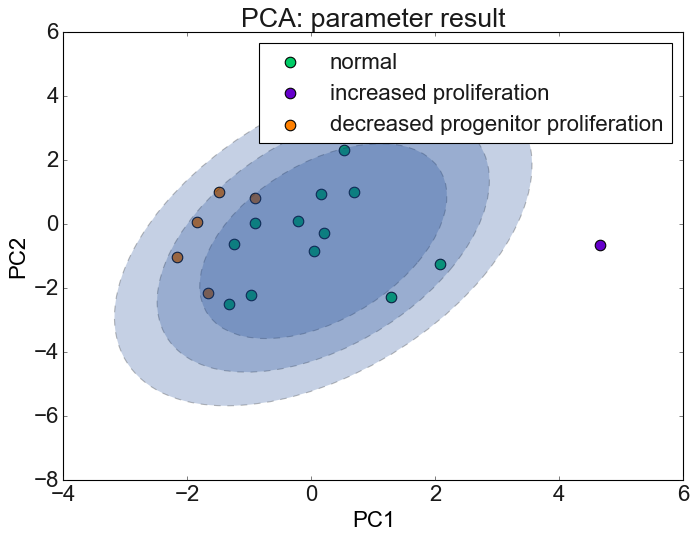

In [740]:
#labels:
comparison_str = 'parameter result'
groups=('normal','increased proliferation', 'decreased progenitor proliferation')
groups_colors=[('normal','#00CC66'),('increased proliferation','#6600CC'),('decreased progenitor proliferation','#FF8000')]
s,y = getValues4PCAplot(comparison_str,DF,groups,opt_sample_ID)
plot_PCA_2D_projection(dir_str, folder_str_H_MDS, subfolder_str_H_MDS,Y,Y_H_1,Y_H_2,y,s,groups,groups_colors,comparison_str,bool_plotIDs,bool_only_age_matched,IDX_PCs,add_file_str,legend_loc,W_H_1,W_H_2,confidence_level,opt_save)